# Imports / API Binance


In [5]:
!pip install python-binance
!pip install pandas
!pip install requests

DEPRECATION: Loading egg at c:\users\ccane\anaconda3\lib\site-packages\btc_markov_price_prediction-1.0-py3.11.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at c:\users\ccane\anaconda3\lib\site-packages\datetime-5.5-py3.11.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at c:\users\ccane\anaconda3\lib\site-packages\fonttools-4.54.1-py3.11-win-amd64.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330


DEPRECATION: Loading egg at c:\users\ccane\anaconda3\lib\site-packages\btc_markov_price_prediction-1.0-py3.11.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at c:\users\ccane\anaconda3\lib\site-packages\datetime-5.5-py3.11.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at c:\users\ccane\anaconda3\lib\site-packages\fonttools-4.54.1-py3.11-win-amd64.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330


DEPRECATION: Loading egg at c:\users\ccane\anaconda3\lib\site-packages\btc_markov_price_prediction-1.0-py3.11.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at c:\users\ccane\anaconda3\lib\site-packages\datetime-5.5-py3.11.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330
DEPRECATION: Loading egg at c:\users\ccane\anaconda3\lib\site-packages\fonttools-4.54.1-py3.11-win-amd64.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation.. Discussion can be found at https://github.com/pypa/pip/issues/12330


In [1]:
# Importamos las bibliotecas necesarias para el análisis
from binance.client import Client  # Cliente para conectarse a la API de Binance
import matplotlib.pyplot as mpl   # Biblioteca para graficar
import matplotlib.dates as mdates # Herramienta para manipular fechas en gráficos
from datetime import datetime     # Módulo para trabajar con fechas y horas
import time                       # Biblioteca para manipulación de tiempo
import numpy as np                # Biblioteca para operaciones numéricas y matrices
import random                     # Biblioteca para generar valores aleatorios

In [2]:
# Abrimos el archivo de texto donde almacenamos las claves de la API
with open('API_Key.txt') as api_file:
    # Leemos las líneas del archivo
    lines = api_file.readlines()
    # Obtenemos y limpiamos la clave pública de la API
    binance_key = lines[0].split('=')[1].strip().strip('"')
    # Obtenemos y limpiamos la clave privada de la API
    binance_secret = lines[1].split('=')[1].strip().strip('"')

In [3]:
# Iniciamos el cliente de Binance utilizando las claves de API para autenticar la conexión
cliente = Client(binance_key, binance_secret)

In [4]:
# Solicitamos el precio actual de BTC en USDT
btc_price = cliente.get_symbol_ticker(symbol="BTCUSDT")
# Imprimimos el precio actual de BTC para verificar que la conexión está funcionando
print(btc_price)

{'symbol': 'BTCUSDT', 'price': '76417.98000000'}


## Datos históricos

In [5]:
klines = cliente.get_historical_klines("BTCUSDT", Client.KLINE_INTERVAL_1HOUR, "1 day ago UTC")

for kline in klines:
    print(kline)

[1731024000000, '75857.89000000', '76358.00000000', '75844.99000000', '76005.25000000', '1567.30594000', 1731027599999, '119311205.04104320', 203064, '830.50494000', '63223848.37551870', '0']
[1731027600000, '76005.24000000', '76329.63000000', '75832.14000000', '75983.91000000', '1139.43516000', 1731031199999, '86657562.86877390', 197798, '486.16621000', '36972964.04602730', '0']
[1731031200000, '75983.91000000', '76020.00000000', '75652.65000000', '75711.14000000', '709.19516000', 1731034799999, '53740676.29217300', 127198, '305.41158000', '23140645.98447240', '0']
[1731034800000, '75711.15000000', '75890.80000000', '75555.00000000', '75890.79000000', '1000.64121000', 1731038399999, '75762625.71859640', 96393, '367.25788000', '27816355.88228690', '0']
[1731038400000, '75890.79000000', '76026.00000000', '75808.04000000', '75832.14000000', '693.63204000', 1731041999999, '52669592.98032170', 74980, '349.16417000', '26515165.74295830', '0']
[1731042000000, '75832.13000000', '76139.8300000

In [15]:
klines_hourly = cliente.get_historical_klines("BTCUSDT", Client.KLINE_INTERVAL_1HOUR, "1460 days ago UTC")
klines_daily = cliente.get_historical_klines("BTCUSDT", Client.KLINE_INTERVAL_1DAY, "1460 days ago UTC")
"""
[
  1499040000000,      # Open time (hora de apertura en formato de timestamp Unix)
  "0.01634790",       # Open (precio de apertura)
  "0.80000000",       # High (precio más alto durante el intervalo)
  "0.01575800",       # Low (precio más bajo durante el intervalo)
  "0.01577100",       # Close (precio de cierre)
  "148976.11427815",  # Volume (volumen de la criptomoneda negociado)
  1499644799999,      # Close time (hora de cierre en formato de timestamp Unix)
  "2434.19055334",    # Quote asset volume (volumen en la otra moneda del par, en este caso, USDT)
  308,                # Number of trades (número de transacciones)
  "1756.87402397",    # Taker buy base asset volume (volumen de la criptomoneda comprada por el lado del comprador)
  "28.46694368",      # Taker buy quote asset volume (volumen en la otra moneda comprada por el lado del comprador)
  "17928899.62484339" # Ignore

"""
# Diccionarios para almacenar datos de tendencia de precios y beneficios para cada intervalo de tiempo
price_trend_hourly = {}
profit_trend_hourly = {} # Beneficio si se abre y cierra el trade en cada hora
profit_percentage_hourly = {}
price_trend_daily = {}
profit_trend_daily = {}
profit_percentage_daily = {}

# Función que extrae y procesa información de cada kline (candela)
def info_scrap(kline, info):
    open_price = kline[1]  # Precio de apertura
    close_price = kline[4] # Precio de cierre
    open_time = kline[0]   # Hora de apertura en Unix timestamp
    close_time = kline[6]  # Hora de cierre en Unix timestamp
    price_change = float(close_price)-float(open_price)  # Cambio absoluto de precio
    price_change_relative = ((float(close_price)-float(open_price))/float(open_price))*100  # Cambio relativo en porcentaje

     # Imprime información detallada sobre la kline
    print(f'*\tOpen time {open_time}')
    print(f'*\tClose time {close_time}')
    print(f'*\tOpen price {open_price}')
    print(f'*\tClose price {close_price}')
    print(f'*\tChange of price {price_change}')
    print(f'*\tChange percentage {price_change_relative}')

    # Guarda los datos en los diccionarios según el intervalo (horario o diario)
    if 'hourly' in info:
      price_trend_hourly[open_time] = open_price
      price_trend_hourly[close_time] = close_price
      profit_trend_hourly[close_time] = price_change
      profit_percentage_hourly[close_time] = price_change_relative
    elif 'daily' in info:
      price_trend_daily[open_time] = open_price
      price_trend_daily[close_time] = close_price
      profit_trend_daily[close_time] = price_change
      profit_percentage_daily[close_time] = price_change_relative

# Procesa y analiza cada kline en el intervalo horario
for kline in klines_hourly:
    print('*HOURLY*\n'+'*'*45)
    info_scrap(kline, 'hourly')

print('*'*100)

# Procesa y analiza cada kline en el intervalo diario
for kline in klines_daily:
    print('*DAILY*\n'+'*'*45)
    info_scrap(kline, 'daily')

*HOURLY*
*********************************************
*	Open time 1604962800000
*	Close time 1604966399999
*	Open price 15242.62000000
*	Close price 15328.41000000
*	Change of price 85.78999999999905
*	Change percentage 0.56282974974118
*HOURLY*
*********************************************
*	Open time 1604966400000
*	Close time 1604969999999
*	Open price 15328.41000000
*	Close price 15300.00000000
*	Change of price -28.409999999999854
*	Change percentage -0.1853421196327594
*HOURLY*
*********************************************
*	Open time 1604970000000
*	Close time 1604973599999
*	Open price 15300.00000000
*	Close price 15392.01000000
*	Change of price 92.01000000000022
*	Change percentage 0.6013725490196093
*HOURLY*
*********************************************
*	Open time 1604973600000
*	Close time 1604977199999
*	Open price 15392.01000000
*	Close price 15339.14000000
*	Change of price -52.8700000000008
*	Change percentage -0.3434899015788113
*HOURLY*
*****************************

# BTC Price Plots


## Hourly BTC Plot

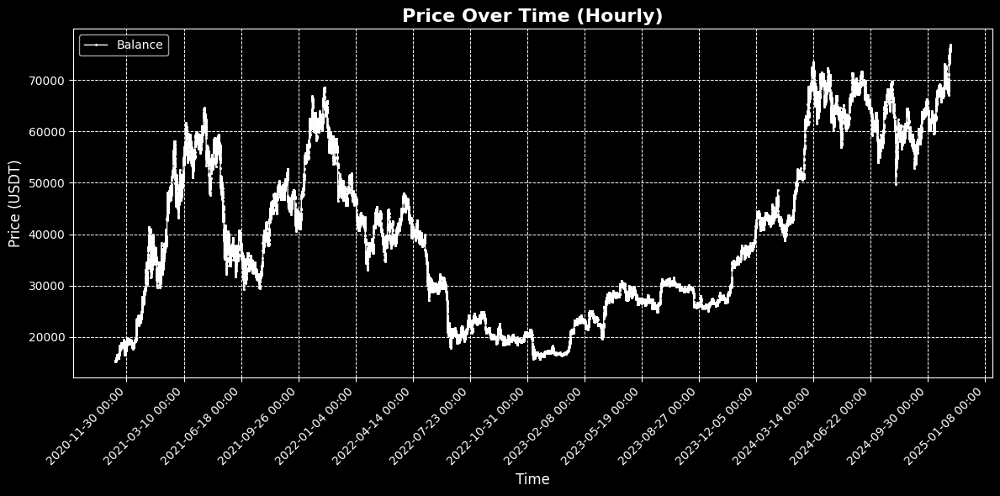

In [16]:
# Inicializa listas para almacenar las marcas de tiempo y los precios correspondientes
timestamps = []  # Lista de timestamps para cada intervalo horario
prices = []      # Lista de precios para cada intervalo horario

# Convierte las marcas de tiempo a formato UTC y las almacena en la lista 'timestamps'
for time_stamp in price_trend_hourly.keys():
    timestamps.append(datetime.utcfromtimestamp(time_stamp / 1000))  # Convierte de milisegundos a segundos

# Convierte los precios a tipo float y los almacena en la lista 'prices'
for price in price_trend_hourly.values():
    prices.append(float(price))  # Convierte el precio a float para evitar errores en la gráfica

# Configura el estilo de la gráfica a fondo oscuro para mejorar la visualización
mpl.style.use('dark_background')

# Crea una figura y un eje con dimensiones de 12x6 pulgadas
fig, ax = mpl.subplots(figsize=(12, 6))

# Dibuja la línea de precios a lo largo del tiempo
ax.plot(
    timestamps,        # Eje x: Timestamps
    prices,            # Eje y: Precios
    color='white',     # Color de la línea en blanco
    marker='o',        # Marcador de cada punto en forma de círculo
    linestyle='-',     # Línea continua entre los puntos
    linewidth=1,       # Grosor de la línea
    markersize=1,      # Tamaño de los marcadores
    label='Balance'    # Etiqueta de la línea para la leyenda
)

# Configura el formato de las etiquetas del eje x a fecha y hora (AAAA-MM-DD HH:MM)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))

# Establece un localizador para el eje x con intervalos de días, espaciando cada 100 días
ax.xaxis.set_major_locator(mdates.DayLocator(interval=100))

# Título de la gráfica con un tamaño de fuente grande y en negrita
mpl.title('Price Over Time (Hourly)', fontsize=16, fontweight='bold')
# Etiquetas de los ejes x e y con un tamaño de fuente moderado
mpl.xlabel('Time', fontsize=12)
mpl.ylabel('Price (USDT)', fontsize=12)

# Rota las etiquetas del eje x para mejorar la legibilidad y las alinea a la derecha
mpl.xticks(rotation=45, ha='right')

# Agrega una leyenda en la esquina superior izquierda de la gráfica
mpl.legend(loc='upper left')

# Activa la cuadrícula con líneas de estilo punteado y grosor moderado
mpl.grid(True, which='both', linestyle='--', linewidth=0.7)

# Ajusta el diseño para evitar el solapamiento de elementos
mpl.tight_layout()

# Muestra la gráfica en pantalla
mpl.show()


## Daily BTC Plot

El código toma los datos de precios diarios de BTCUSDT, almacenados en `price_trend_daily`, y los visualiza en un gráfico de línea usando `matplotlib`. Esta gráfica muestra la tendencia diaria de los precios a lo largo del tiempo, con un estilo de fondo oscuro y personalizaciones que facilitan la lectura y análisis de los datos. Esto es útil para evaluar tendencias y patrones de largo plazo, proporcionando una base para el análisis de tendencias en trading, especialmente para modelado con una cadena de Markov.


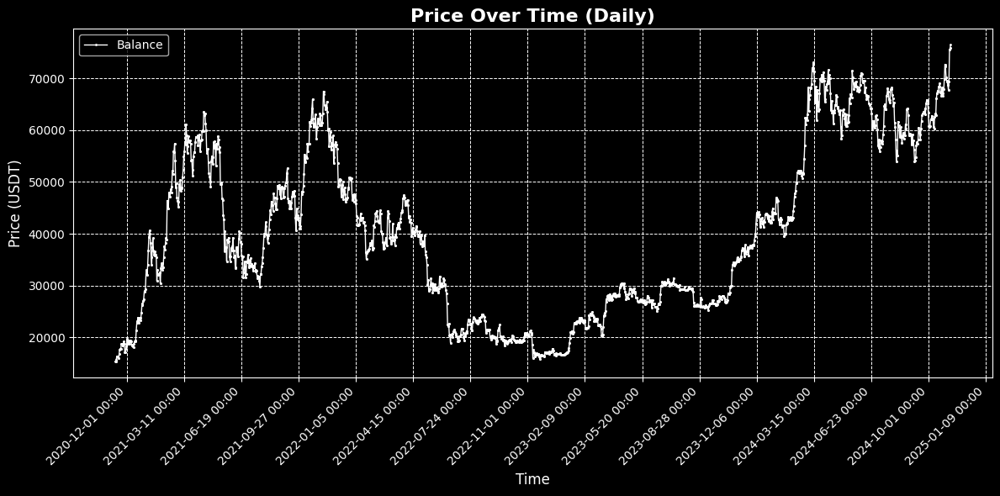

In [17]:
# Inicializa listas para almacenar las marcas de tiempo y los precios correspondientes en el intervalo diario
timestamps = []  # Lista de timestamps para cada día
prices = []      # Lista de precios para cada día

# Convierte las marcas de tiempo a formato UTC y las almacena en la lista 'timestamps'
for time_stamp in price_trend_daily.keys():
    timestamps.append(datetime.utcfromtimestamp(time_stamp / 1000))  # Convierte de milisegundos a segundos

# Convierte los precios a tipo float y los almacena en la lista 'prices'
for price in price_trend_daily.values():
    prices.append(float(price))  # Convierte el precio a float para evitar errores en la gráfica

# Configura el estilo de la gráfica a fondo oscuro para mejorar la visualización
mpl.style.use('dark_background')

# Crea una figura y un eje con dimensiones de 12x6 pulgadas
fig, ax = mpl.subplots(figsize=(12, 6))

# Dibuja la línea de precios a lo largo del tiempo
ax.plot(
    timestamps,        # Eje x: Timestamps diarios
    prices,            # Eje y: Precios diarios
    color='white',     # Color de la línea en blanco
    marker='o',        # Marcador de cada punto en forma de círculo
    linestyle='-',     # Línea continua entre los puntos
    linewidth=1,       # Grosor de la línea
    markersize=1,      # Tamaño de los marcadores
    label='Balance'    # Etiqueta de la línea para la leyenda
)

# Configura el formato de las etiquetas del eje x a fecha y hora (AAAA-MM-DD HH:MM)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))

# Establece un localizador para el eje x con intervalos de días, espaciando cada 100 días
ax.xaxis.set_major_locator(mdates.DayLocator(interval=100))

# Título de la gráfica con un tamaño de fuente grande y en negrita
mpl.title('Price Over Time (Daily)', fontsize=16, fontweight='bold')
# Etiquetas de los ejes x e y con un tamaño de fuente moderado
mpl.xlabel('Time', fontsize=12)
mpl.ylabel('Price (USDT)', fontsize=12)

# Rota las etiquetas del eje x para mejorar la legibilidad y las alinea a la derecha
mpl.xticks(rotation=45, ha='right')

# Agrega una leyenda en la esquina superior izquierda de la gráfica
mpl.legend(loc='upper left')

# Activa la cuadrícula con líneas de estilo punteado y grosor moderado
mpl.grid(True, which='both', linestyle='--', linewidth=0.7)

# Ajusta el diseño para evitar el solapamiento de elementos
mpl.tight_layout()

# Muestra la gráfica en pantalla
mpl.show()


# Price Variations

## Hourly Variations

En esta sección, el código visualiza la variación horaria del precio de BTCUSDT utilizando los datos de `profit_trend_hourly`, que representa los cambios absolutos en el precio de hora en hora. La gráfica se configura con un estilo de fondo oscuro para facilitar su análisis en entornos de trading, ayudando a detectar patrones de volatilidad y oscilaciones de precio que podrían influir en estrategias de trading basadas en cadenas de Markov.


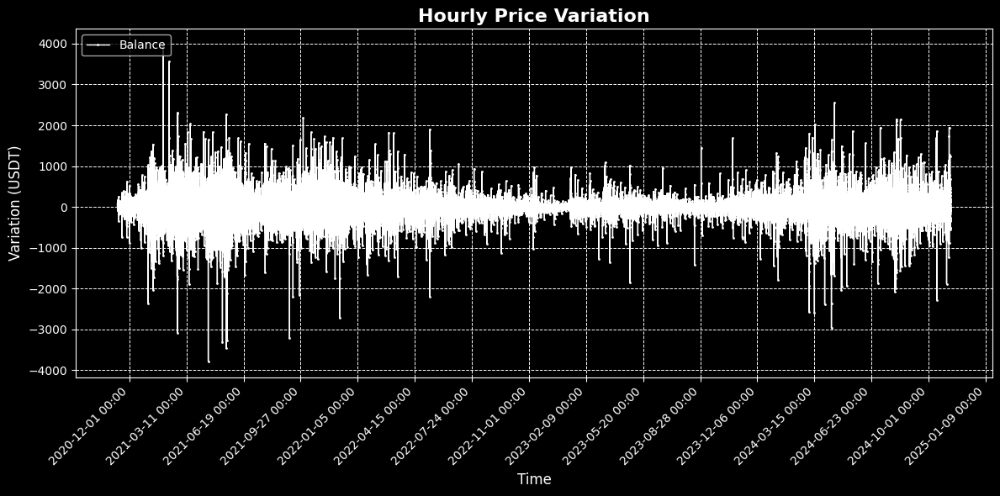

In [18]:
# Inicializa listas para almacenar las marcas de tiempo y las variaciones de precio correspondientes en el intervalo horario
timestamps = []  # Lista de timestamps para cada intervalo horario
prices = []      # Lista de variaciones de precio para cada intervalo horario

# Convierte las marcas de tiempo a formato UTC y las almacena en la lista 'timestamps'
for time_stamp in profit_trend_hourly.keys():
    timestamps.append(datetime.utcfromtimestamp(time_stamp / 1000))  # Convierte de milisegundos a segundos

# Convierte las variaciones de precio a tipo float y las almacena en la lista 'prices'
for price in profit_trend_hourly.values():
    prices.append(float(price))  # Convierte el precio a float para evitar errores en la gráfica

# Configura el estilo de la gráfica a fondo oscuro para mejorar la visualización
mpl.style.use('dark_background')

# Crea una figura y un eje con dimensiones de 12x6 pulgadas
fig, ax = mpl.subplots(figsize=(12, 6))

# Dibuja la línea de variaciones de precio a lo largo del tiempo
ax.plot(
    timestamps,        # Eje x: Timestamps horarios
    prices,            # Eje y: Variaciones de precio horario
    color='white',     # Color de la línea en blanco
    marker='o',        # Marcador de cada punto en forma de círculo
    linestyle='-',     # Línea continua entre los puntos
    linewidth=1,       # Grosor de la línea
    markersize=1,      # Tamaño de los marcadores
    label='Balance'    # Etiqueta de la línea para la leyenda
)

# Configura el formato de las etiquetas del eje x a fecha y hora (AAAA-MM-DD HH:MM)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))

# Establece un localizador para el eje x con intervalos de días, espaciando cada 100 días
ax.xaxis.set_major_locator(mdates.DayLocator(interval=100))

# Título de la gráfica con un tamaño de fuente grande y en negrita
mpl.title('Hourly Price Variation', fontsize=16, fontweight='bold')
# Etiquetas de los ejes x e y con un tamaño de fuente moderado
mpl.xlabel('Time', fontsize=12)
mpl.ylabel('Variation (USDT)', fontsize=12)

# Rota las etiquetas del eje x para mejorar la legibilidad y las alinea a la derecha
mpl.xticks(rotation=45, ha='right')

# Agrega una leyenda en la esquina superior izquierda de la gráfica
mpl.legend(loc='upper left')

# Activa la cuadrícula con líneas de estilo punteado y grosor moderado
mpl.grid(True, which='both', linestyle='--', linewidth=0.7)

# Ajusta el diseño para evitar el solapamiento de elementos
mpl.tight_layout()

# Muestra la gráfica en pantalla
mpl.show()


## Daily Variations

El código visualiza la variación diaria del precio de BTCUSDT usando los datos de `profit_trend_daily`, que representan los cambios absolutos en el precio de un día a otro. Esta gráfica de fondo oscuro ayuda a evaluar la volatilidad diaria, identificando patrones y movimientos significativos a lo largo de un período extenso. Este análisis es útil para estrategias de trading basadas en variaciones de precio, como las implementadas con modelos de cadenas de Markov.


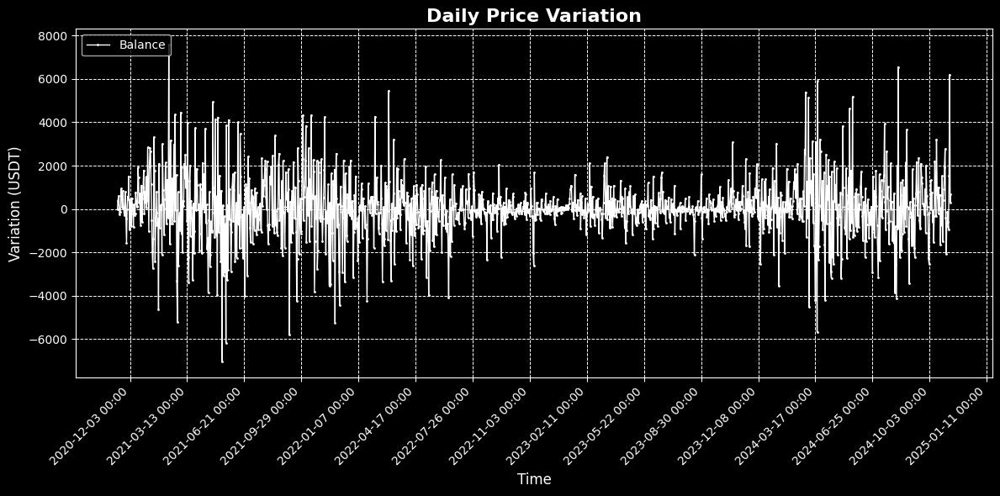

In [19]:
# Inicializa listas para almacenar las marcas de tiempo y las variaciones de precio correspondientes en el intervalo diario
timestamps = []  # Lista de timestamps para cada día
prices = []      # Lista de variaciones de precio para cada día

# Convierte las marcas de tiempo a formato UTC y las almacena en la lista 'timestamps'
for time_stamp in profit_trend_daily.keys():
    timestamps.append(datetime.utcfromtimestamp(time_stamp / 1000))  # Convierte de milisegundos a segundos

# Convierte las variaciones de precio a tipo float y las almacena en la lista 'prices'
for price in profit_trend_daily.values():
    prices.append(float(price))  # Convierte el precio a float para evitar errores en la gráfica

# Configura el estilo de la gráfica a fondo oscuro para mejorar la visualización
mpl.style.use('dark_background')

# Crea una figura y un eje con dimensiones de 12x6 pulgadas
fig, ax = mpl.subplots(figsize=(12, 6))

# Dibuja la línea de variaciones de precio a lo largo del tiempo
ax.plot(
    timestamps,        # Eje x: Timestamps diarios
    prices,            # Eje y: Variaciones de precio diario
    color='white',     # Color de la línea en blanco
    marker='o',        # Marcador de cada punto en forma de círculo
    linestyle='-',     # Línea continua entre los puntos
    linewidth=1,       # Grosor de la línea
    markersize=1,      # Tamaño de los marcadores
    label='Balance'    # Etiqueta de la línea para la leyenda
)

# Configura el formato de las etiquetas del eje x a fecha y hora (AAAA-MM-DD HH:MM)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))

# Establece un localizador para el eje x con intervalos de días, espaciando cada 100 días
ax.xaxis.set_major_locator(mdates.DayLocator(interval=100))

# Título de la gráfica con un tamaño de fuente grande y en negrita
mpl.title('Daily Price Variation', fontsize=16, fontweight='bold')
# Etiquetas de los ejes x e y con un tamaño de fuente moderado
mpl.xlabel('Time', fontsize=12)
mpl.ylabel('Variation (USDT)', fontsize=12)

# Rota las etiquetas del eje x para mejorar la legibilidad y las alinea a la derecha
mpl.xticks(rotation=45, ha='right')

# Agrega una leyenda en la esquina superior izquierda de la gráfica
mpl.legend(loc='upper left')

# Activa la cuadrícula con líneas de estilo punteado y grosor moderado
mpl.grid(True, which='both', linestyle='--', linewidth=0.7)

# Ajusta el diseño para evitar el solapamiento de elementos
mpl.tight_layout()

# Muestra la gráfica en pantalla
mpl.show()


## Daily Variation (%)

El código visualiza la variación diaria en porcentaje del precio de BTCUSDT utilizando los datos de `profit_percentage_daily`, que representan el cambio porcentual diario de un precio de cierre a otro. Este tipo de gráfico es útil para observar la magnitud relativa de las fluctuaciones de precio día a día, lo que permite analizar la volatilidad en términos porcentuales, información valiosa en la toma de decisiones para estrategias de trading y modelos de predicción, como una cadena de Markov.


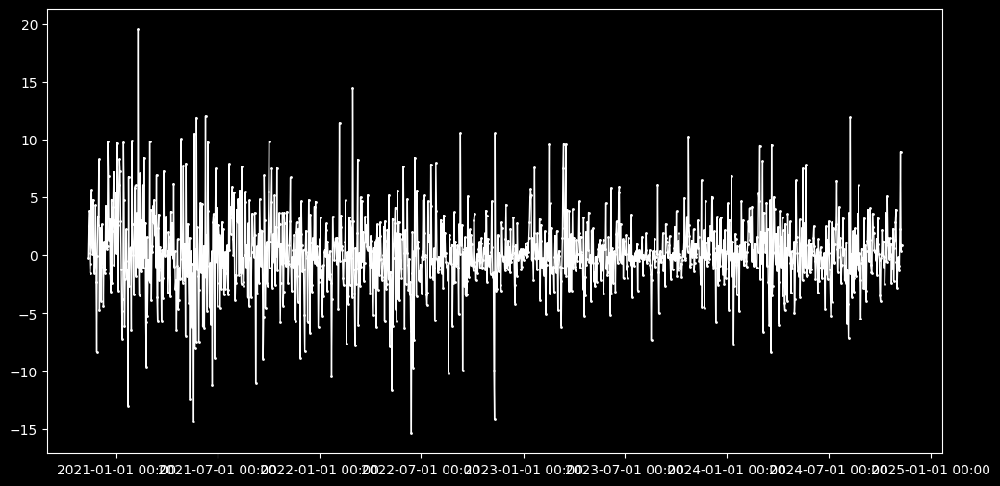

In [20]:
# Inicializa listas para almacenar las marcas de tiempo y las variaciones porcentuales de precio correspondientes en el intervalo diario
timestamps = []  # Lista de timestamps para cada día
prices = []      # Lista de variaciones porcentuales de precio para cada día

# Convierte las marcas de tiempo a formato UTC y las almacena en la lista 'timestamps'
for time_stamp in profit_percentage_daily.keys():
    timestamps.append(datetime.utcfromtimestamp(time_stamp / 1000))  # Convierte de milisegundos a segundos

# Convierte las variaciones porcentuales de precio a tipo float y las almacena en la lista 'prices'
for price in profit_percentage_daily.values():
    prices.append(float(price))  # Convierte el valor a float para evitar errores en la gráfica

# Configura el estilo de la gráfica a fondo oscuro para mejorar la visualización
mpl.style.use('dark_background')

# Crea una figura y un eje con dimensiones de 12x6 pulgadas
fig, ax = mpl.subplots(figsize=(12, 6))

# Dibuja la línea de variaciones porcentuales de precio a lo largo del tiempo
ax.plot(
    timestamps,        # Eje x: Timestamps diarios
    prices,            # Eje y: Variación porcentual diaria de precio
    color='white',     # Color de la línea en blanco
    marker='o',        # Marcador de cada punto en forma de círculo
    linestyle='-',     # Línea continua entre los puntos
    linewidth=1,       # Grosor de la línea
    markersize=1,      # Tamaño de los marcadores
    label='Balance'    # Etiqueta de la línea para la leyenda
)

# Configura el formato de las etiquetas del eje x a fecha y hora (AAAA-MM-DD HH:MM)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))

# Establece un localizador para el eje x con i


## Declaraciones de "estados"

### Traducción de Movimientos de Precio a Estados de Mercado
Definimos los estados de mercado (`bajada`, `subida`, `estable`) y la función `traducción_movimientos`, que traduce los cambios porcentuales diarios en categorías de movimientos de mercado o en valores numéricos. Los estados reflejan la tendencia general de cada cambio de precio en función de un umbral del 0.5%, categorizando los movimientos como sigue:

- **Subida**: Cambio mayor al 0.5%.
- **Bajada**: Cambio menor al -0.5%.
- **Estable**: Cambio dentro del rango [-0.5%, +0.5%].

Esta categorización puede ser usada para entrenar un modelo de cadena de Markov, donde los estados discretos facilitan el análisis de transiciones entre diferentes condiciones del mercado.


In [21]:
estados = ['bajada','subida','estable']

In [22]:
# Definición de los estados de mercado
estados = ['bajada', 'subida', 'estable']

# Función que traduce los cambios porcentuales en categorías de estados de mercado o en valores numéricos
def traducción_movimientos(cambios_porcentuales, modo='estados'):
    matriz_cambios = {}  # Diccionario para almacenar el estado correspondiente a cada cambio de precio

    # Condición para usar estados de mercado
    if modo == 'estados':
        for key, value in cambios_porcentuales.items():
            if value > 0.5:
                matriz_cambios[key] = estados[1]  # 'subida' para cambios mayores al 0.5%
            elif value < -0.5:
                matriz_cambios[key] = estados[0]  # 'bajada' para cambios menores al -0.5%
            elif value > -0.5 and value < 0.5:
                matriz_cambios[key] = estados[2]  # 'estable' para cambios entre -0.5% y +0.5%
        return matriz_cambios

    # Condición para usar valores numéricos en lugar de estados
    elif modo == 'numeros':
        for key, value in cambios_porcentuales.items():
            if value > 0.5:
                matriz_cambios[key] = 1     # +1 para 'subida'
            elif value < -0.5:
                matriz_cambios[key] = -1    # -1 para 'bajada'
            elif value > -0.5 and value < 0.5:
                matriz_cambios[key] = 0     # 0 para 'estable'
        return matriz_cambios

    # En caso de recibir un modo no válido
    else:
        return 'Tienes que dar un modo válido'


La función `traducción_movimientos` permite clasificar los cambios porcentuales diarios en estados de mercado (texto o valores numéricos) según el parámetro `modo`. Esto facilita la interpretación de los datos y es especialmente útil en el contexto de un modelo de cadena de Markov para analizar transiciones entre los estados `bajada`, `subida` y `estable`.

La función clasifica cada cambio de precio de la siguiente forma:

- **Modo 'estados'**: Convierte los cambios en términos descriptivos (`bajada`, `subida`, `estable`).
- **Modo 'numeros'**: Convierte los cambios en valores numéricos (+1, -1, 0) según la dirección del cambio.

Estos estados categorizados pueden luego ser utilizados para analizar la secuencia de cambios de precio y modelar probabilidades de transición entre estados.

### Obtención de Cambios de Estado a Partir de las Variaciones Porcentuales
Se utilizan las funciones definidas anteriormente para obtener las matrices de cambios en forma de estados (`bajada`, `subida`, `estable`) y en valores numéricos (1, -1, 0). Estas matrices se derivan de los cambios porcentuales en los precios horarios y diarios, facilitando el análisis de las variaciones de precio en diferentes intervalos de tiempo.

Los resultados generados pueden utilizarse para construir modelos de cadenas de Markov, donde los estados discretos (tanto descriptivos como numéricos) permiten estudiar las transiciones entre los diferentes escenarios de mercado.


In [23]:
# Obtiene los cambios de estado (subida/bajada/estable) a partir de las variaciones porcentuales en el intervalo horario
matriz_cambios_estados = traducción_movimientos(profit_percentage_hourly)  # Matriz de cambios en estados (horarios)
matriz_cambios_estados_horarios = matriz_cambios_estados  # Alias para la matriz de estados horarios

# Obtiene los cambios de estado a partir de las variaciones porcentuales en el intervalo diario
matriz_cambios_estados_diarios = traducción_movimientos(profit_percentage_daily)  # Matriz de cambios en estados (diarios)

# Obtiene los cambios en forma numérica (1, -1, 0) a partir de las variaciones porcentuales en el intervalo horario
matriz_cambios_numeros = traducción_movimientos(profit_percentage_hourly, 'numeros')  # Matriz de cambios numéricos (horarios)
matriz_cambios_numeros_horarios = matriz_cambios_numeros  # Alias para la matriz de números horarios

# Obtiene los cambios en forma numérica a partir de las variaciones porcentuales en el intervalo diario
matriz_cambios_numeros_diarios = traducción_movimientos(profit_percentage_daily, 'numeros')  # Matriz de cambios numéricos (diarios)


Se han creado cuatro matrices a partir de los datos de variación porcentual de precios:
1. **`matriz_cambios_estados_horarios`**: Cambios horarios en forma de estados (`bajada`, `subida`, `estable`).
2. **`matriz_cambios_estados_diarios`**: Cambios diarios en forma de estados.
3. **`matriz_cambios_numeros_horarios`**: Cambios horarios en forma numérica (1, -1, 0).
4. **`matriz_cambios_numeros_diarios`**: Cambios diarios en forma numérica.

Estas matrices permiten representar los movimientos de precio de manera estructurada, lo que facilita su uso en modelos de predicción de patrones de mercado, como los modelos de cadenas de Markov. Este paso prepara los datos para un análisis de probabilidades de transición entre estados, clave en estrategias de trading basadas en patrones históricos.


# Simple Markov Chain Algorithm (Observing 1 past state)

## Markov Transition Matrix

In [24]:
matriz_transicion = np.zeros((3,3))
(matriz_transicion)

array([[0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.]])

### In this case ill be backtesting for daily and hourly so ill have to make 2 transition matrixes

### Construcción de la Matriz de Transición para el Modelo de Cadena de Markov
Construimos una matriz de transición para un modelo de cadena de Markov utilizando los estados horarios de cambios de precio (`bajada`, `subida`, `estable`). La matriz de transición captura las probabilidades de moverse de un estado a otro de un intervalo a otro, información esencial para predecir futuros estados del mercado basados en el historial.

Cada transición se cuenta en la matriz de transición, y luego se normaliza para obtener las probabilidades de transición, lo cual facilita el análisis y la predicción de los movimientos de mercado.


In [25]:
# Ordena las fechas de los estados horarios para procesar las transiciones cronológicamente
fechas_ordenadas = sorted(matriz_cambios_estados_horarios.keys())

# Inicializa la matriz de transición (se asume que matriz_transicion ya está definida y es una matriz de ceros)
for i in range(len(fechas_ordenadas)-1):
    fecha_actual = fechas_ordenadas[i]
    fecha_mañana = fechas_ordenadas[i+1]

    # Obtiene el estado actual y el estado siguiente de la matriz de estados horarios
    estado_actual = matriz_cambios_estados_horarios[fecha_actual]
    estado_mañana = matriz_cambios_estados_horarios[fecha_mañana]

    # Mapea los estados a sus índices en la lista 'estados' (0 para 'bajada', 1 para 'subida', 2 para 'estable')
    estado1 = estados.index(estado_actual)
    estado2 = estados.index(estado_mañana)

    # Incrementa el contador en la matriz de transición en la posición correspondiente a (estado actual, estado siguiente)
    matriz_transicion[estado1, estado2] += 1 

# Normaliza la matriz de transición para obtener las probabilidades de transición entre estados
matriz_transicion_normalizada_horaria = matriz_transicion / matriz_transicion.sum(axis=1, keepdims=True)


1. **Construcción de la Matriz**: La matriz de transición registra cuántas veces ocurre cada transición de un estado a otro entre intervalos horarios consecutivos. 
2. **Normalización**: Después de contar todas las transiciones, se normaliza la matriz dividiendo cada fila entre la suma de sus elementos, obteniendo así la probabilidad de pasar de un estado a otro. Esto transforma la matriz de transición en un conjunto de probabilidades.

La matriz de transición normalizada es un componente esencial de un modelo de cadena de Markov, ya que permite realizar predicciones sobre futuros estados del mercado en función de los patrones de transición observados.


### Construcción de la Matriz de Transición Diaria para el Modelo de Cadena de Markov
Esta celda construye una matriz de transición diaria utilizando los estados diarios de cambios de precio (`bajada`, `subida`, `estable`). Similar a la matriz horaria, esta matriz de transición diaria captura las probabilidades de pasar de un estado a otro de un día a otro, proporcionando una representación de las transiciones de mercado en un intervalo de tiempo más amplio.

Las transiciones se cuentan y luego la matriz de transición se normaliza para reflejar las probabilidades, lo cual es clave para modelar y predecir movimientos de mercado en una escala diaria.


In [26]:
# Ordena las fechas de los estados diarios para procesar las transiciones cronológicamente
fechas_ordenadas = sorted(matriz_cambios_estados_diarios.keys())

# Inicializa la matriz de transición (se asume que matriz_transicion ya está definida y es una matriz de ceros)
for i in range(len(fechas_ordenadas)-1):
    fecha_actual = fechas_ordenadas[i]
    fecha_mañana = fechas_ordenadas[i+1]

    # Obtiene el estado actual y el estado siguiente de la matriz de estados diarios
    estado_actual = matriz_cambios_estados_diarios[fecha_actual]
    estado_mañana = matriz_cambios_estados_diarios[fecha_mañana]

    # Mapea los estados a sus índices en la lista 'estados' (0 para 'bajada', 1 para 'subida', 2 para 'estable')
    estado1 = estados.index(estado_actual)
    estado2 = estados.index(estado_mañana)

    # Incrementa el contador en la matriz de transición en la posición correspondiente a (estado actual, estado siguiente)
    matriz_transicion[estado1, estado2] += 1 

# Normaliza la matriz de transición para obtener las probabilidades de transición entre estados
matriz_transicion_normalizada_diaria = matriz_transicion / matriz_transicion.sum(axis=1, keepdims=True)


1. **Construcción de la Matriz**: Se registra la frecuencia de cada transición de un estado a otro entre días consecutivos.
2. **Normalización**: Cada fila de la matriz de transición se divide entre la suma de sus elementos para obtener la probabilidad de moverse de un estado a otro.

La matriz de transición normalizada diaria se usa en un modelo de cadena de Markov para analizar la probabilidad de cambios en el mercado de un día al siguiente. Esto permite una visión de la dinámica de mercado en una escala de tiempo diaria, ayudando a predecir patrones de comportamiento basados en transiciones históricas.


### Probability Obtention for the data

### Visualización de la Matriz de Transición y Traducción de Estados
Imprimimos la matriz de transición normalizada horaria (`matriz_transicion_normalizada_horaria`) y ofrece una interpretación de sus índices en términos de los estados de mercado (`bajada`, `subida`, `estable`). Esto permite entender la probabilidad de pasar de un estado a otro en cada fila y columna de la matriz, con un mapeo claro de los índices de la matriz a los estados de mercado descriptivos.


In [27]:
# Imprime la matriz de transición normalizada para los cambios horarios
print('La matriz de transición resulta en la siguiente:\n', matriz_transicion_normalizada_horaria)

# Mapea los índices de la matriz a los estados de mercado (0 = bajada, 1 = subida, 2 = estable)
# La lista 'lista' contiene el mapeo en forma descriptiva de cada transición entre estados
lista = [[0,0,0],[0,0,0],[0,0,0]]

"""
Recordemos que los estados se definen como: 
estados = ['bajada', 'subida', 'estable']
"""

# Imprime la interpretación de los índices de la matriz de transición en términos de los estados
print('\n', '*'*50, '\nY los estados, índices de la matriz, se traducen a los siguientes:\n', '*'*50)
for i in range(len(estados)):
    for j in range(len(estados)):
        lista[i][j] = f'{estados[i]} --> {estados[j]}'  # Traduce la transición de estado en texto

# Muestra el mapeo de cada fila de transiciones en términos de los estados descriptivos
for fila in lista:
    print(fila)


La matriz de transición resulta en la siguiente:
 [[0.20594666 0.23961522 0.55443813]
 [0.19278607 0.20833333 0.5988806 ]
 [0.10546036 0.10624097 0.78829866]]

 ************************************************** 
Y los estados, índices de la matriz, se traducen a los siguientes:
 **************************************************
['bajada --> bajada', 'bajada --> subida', 'bajada --> estable']
['subida --> bajada', 'subida --> subida', 'subida --> estable']
['estable --> bajada', 'estable --> subida', 'estable --> estable']


1. **Matriz de Transición Normalizada**: La salida muestra la matriz de transición normalizada horaria, donde cada valor representa la probabilidad de pasar de un estado a otro en el siguiente intervalo horario.
2. **Traducción de Estados**: A continuación, se muestra una tabla de interpretación, en la que cada índice de la matriz se traduce a una transición descriptiva entre estados (`bajada`, `subida`, `estable`). Esto facilita la lectura y el análisis de la matriz de transición, especialmente en el contexto de estrategias de trading basadas en modelos de cadena de Markov.

Esta estructura de salida permite interpretar rápidamente la probabilidad de cada transición y facilita el uso de la matriz para hacer predicciones sobre futuros movimientos de mercado.


### Creación de un Diccionario de Probabilidades de Transición
Se construye un diccionario (`dicc_probabilidades`) que asocia cada transición de estado con su probabilidad correspondiente, utilizando los datos de la matriz de transición normalizada horaria (`matriz_transicion_normalizada_horaria`). Este diccionario permite un acceso rápido a las probabilidades de transición entre estados (`bajada`, `subida`, `estable`) y facilita su interpretación en aplicaciones de trading basadas en modelos de cadenas de Markov.


In [28]:
# Inicializa un diccionario para almacenar las probabilidades de transición con descripciones claras
dicc_probabilidades = {}

# Asocia cada transición de estado (ej. 'bajada --> subida') con su probabilidad correspondiente de la matriz de transición
for i in range(len(lista)):
    for j in range(len(lista[i])):
        dicc_probabilidades[lista[i][j]] = matriz_transicion_normalizada_horaria[i][j]

dicc_probabilidades

{'bajada --> bajada': 0.20594665500655882,
 'bajada --> subida': 0.23961521644075207,
 'bajada --> estable': 0.5544381285526891,
 'subida --> bajada': 0.1927860696517413,
 'subida --> subida': 0.20833333333333334,
 'subida --> estable': 0.5988805970149254,
 'estable --> bajada': 0.10546036454470942,
 'estable --> subida': 0.10624097420085087,
 'estable --> estable': 0.7882986612544397}

### Explicación del Diccionario de Probabilidades de Transición
El diccionario `dicc_probabilidades` almacena cada transición posible en el formato descriptivo (`'bajada --> subida'`, `'subida --> estable'`, etc.), junto con su probabilidad de ocurrencia. Este diccionario simplifica el análisis de las probabilidades de transición entre estados y es útil para realizar predicciones basadas en las probabilidades de cada cambio de estado en el modelo de cadena de Markov.

Por ejemplo, el valor asociado a `'bajada --> subida'` representa la probabilidad de que, dado un estado actual de bajada, el siguiente estado sea de subida en el próximo intervalo horario.


### Modelo de prediccion

### Función para Predecir el Próximo Estado del Mercado
Se define de la función `predecir_estado`, que utiliza la matriz de transición normalizada para predecir el siguiente estado del mercado a partir de un estado actual. Esta predicción se realiza con base en el modelo de cadena de Markov.


In [29]:
def predecir_estado(estado_actual, matriz_transicion_normalizada = matriz_transicion_normalizada_horaria):

    # Obtiene el índice correspondiente al estado actual en la lista de estados
    indice_estado_actual = estados.index(estado_actual)

    # Selecciona el próximo estado usando las probabilidades de la matriz de transición para el estado actual
    estado_predecido = random.choices(estados, matriz_transicion_normalizada[indice_estado_actual])[0]

    # Retorna el estado actual y el estado predicho para el siguiente intervalo
    return estado_actual, estado_predecido


### Descripción de la Función `predecir_estado`
1. **Identificación del Índice del Estado Actual**: 
   - La función encuentra el índice del `estado_actual` en la lista de estados (`estados = ['bajada', 'subida', 'estable']`). Este índice se usa para seleccionar la fila correspondiente en `matriz_transicion_normalizada`.

2. **Selección del Próximo Estado**:
   - Utilizando `random.choices`, la función elige un próximo estado aleatoriamente, ponderado por las probabilidades en la fila correspondiente de la matriz de transición. Esta función devuelve una lista, por lo que se toma el primer elemento (`[0]`) para obtener el estado.

3. **Retorno de Resultados**:
   - La función devuelve el `estado_actual` y el `estado_predecido`, facilitando la evaluación de la transición predicha a partir del estado actual en el contexto de un modelo de cadena de Markov.


### Prueba de Predicción de Estados para Diferentes Estados Iniciales
Ejecutamos varias simulaciones para predecir el siguiente estado a partir de cada uno de los posibles estados iniciales (`subida`, `bajada`, `estable`). Se realizan 10 predicciones para cada estado inicial, y los resultados se almacenan en tres diccionarios distintos (`dicc_prueba_subida`, `dicc_prueba_bajada`, `dicc_prueba_estable`) para contar las ocurrencias de cada estado predicho.


In [30]:
# Inicializa tres diccionarios para contar las predicciones de cada estado inicial
dicc_prueba_subida = {}  # Para el estado inicial 'subida'
dicc_prueba_bajada = {}  # Para el estado inicial 'bajada'
dicc_prueba_estable = {}  # Para el estado inicial 'estable'

# Ejecuta 10 predicciones para cada estado inicial ('subida', 'bajada', 'estable')
for i in range(10):
    # Predice el próximo estado desde el estado inicial 'subida'
    actual1, predecido1 = predecir_estado('subida')
    # Predice el próximo estado desde el estado inicial 'bajada'
    actual2, predecido2 = predecir_estado('bajada')
    # Predice el próximo estado desde el estado inicial 'estable'
    actual3, predecido3 = predecir_estado('estable')

    # Actualiza el diccionario para el estado inicial 'subida' contando el estado predicho
    if predecido1 not in dicc_prueba_subida:
        dicc_prueba_subida[predecido1] = 0  # Inicializa el conteo si el estado predicho es nuevo
    else:
        dicc_prueba_subida[predecido1] += 1  # Incrementa el conteo si el estado predicho ya existe

    # Actualiza el diccionario para el estado inicial 'bajada' contando el estado predicho
    if predecido2 not in dicc_prueba_bajada:
        dicc_prueba_bajada[predecido2] = 0
    else:
        dicc_prueba_bajada[predecido2] += 1

    # Actualiza el diccionario para el estado inicial 'estable' contando el estado predicho
    if predecido3 not in dicc_prueba_estable:
        dicc_prueba_estable[predecido3] = 0
    else:
        dicc_prueba_estable[predecido3] += 1


### Descripción de la Lógica de Conteo de Predicciones
1. **Inicialización de Diccionarios de Prueba**:
   - `dicc_prueba_subida`, `dicc_prueba_bajada`, y `dicc_prueba_estable` se inicializan para almacenar el conteo de estados predichos para cada uno de los estados iniciales posibles.

2. **Predicción de Estados**:
   - Para cada iteración, la función `predecir_estado` se llama con los estados iniciales `'subida'`, `'bajada'`, y `'estable'`, y el estado predicho se obtiene.

3. **Conteo de Resultados**:
   - Si el estado predicho no está en el diccionario correspondiente, se agrega con un valor inicial de 0.
   - Si el estado ya existe, su conteo se incrementa en 1.
   
Este proceso permite observar la frecuencia con la que cada estado es predicho desde un estado inicial específico, proporcionando información sobre las probabilidades de transición observadas en la simulación.


#### Comprobamos las predicciones, y vemos que según la tabla de transición tiene mucho sentido

In [31]:
print(f'Prueba en estado estable: {dicc_prueba_estable}')
print(f'Prueba en estado subida: {dicc_prueba_subida}')
print(f'Prueba en estado bajada: {dicc_prueba_bajada}')

Prueba en estado estable: {'estable': 8, 'subida': 0}
Prueba en estado subida: {'estable': 5, 'subida': 2, 'bajada': 0}
Prueba en estado bajada: {'estable': 4, 'bajada': 1, 'subida': 2}


# Backtesting 1

### Backtesting with a Daily TF

### Simulación de Estrategia de Trading Basada en Predicciones de Estado
Se simula una estrategia de trading basada en las predicciones de cambio de estado diario. La estrategia se inicia con un capital inicial, y dependiendo de las predicciones de estado (`subida`, `bajada`, `estable`), decide comprar, vender o mantener la posición en BTCUSDT. La simulación realiza un seguimiento de las transacciones y calcula el capital final, junto con las ganancias o pérdidas totales.


In [32]:
# Capital y variables iniciales
capital_inicial = 1000         # Capital de inicio
capital = capital_inicial        # Capital actual, se actualizará durante la simulación
unidades = 0                     # Cantidad de unidades (BTC) en posesión
estado_ahora = 'subida'          # Estado inicial (ej. el mercado comienza en estado de 'subida')
operaciones_totales = 0          # Contador de operaciones de compra y venta
operaciones_venta = 0            # Contador específico para operaciones de venta
seguimiento_capital_diario = {}  # Diccionario para registrar el capital después de cada venta

# Simulación del trading diario según las predicciones de estado futuro
for fecha in price_trend_daily.keys():
    # Predice el estado futuro usando el estado actual y la matriz de transición diaria
    estado_ahora, estado_futuro = predecir_estado(estado_ahora, matriz_transicion_normalizada_diaria)

    # Precio de BTC en el día actual
    precio_hoy = price_trend_daily[fecha]

    # Estrategia de compra: Si el estado futuro es 'subida' y hay capital disponible
    if estado_futuro == 'subida' and capital > 0:
        unidades = capital / float(precio_hoy)  # Compra la cantidad de BTC que se puede con el capital disponible
        capital = 0                             # Todo el capital se invierte en BTC
        print(f'+ Comprar en {fecha}: {unidades} unidades a {precio_hoy} USD')
        operaciones_totales += 1                # Incrementa el contador de operaciones

    # Estrategia de venta: Si el estado futuro es 'bajada' y hay unidades en posesión
    elif estado_futuro == 'bajada' and unidades > 0:
        capital = unidades * float(precio_hoy)  # Vende todas las unidades y actualiza el capital
        print(f"- Vender en {fecha}: capital total ahora es {capital} USD")
        unidades = 0                            # Se venden todas las unidades
        operaciones_totales += 1                # Incrementa el contador de operaciones
        operaciones_venta += 1                  # Incrementa el contador de operaciones de venta
        seguimiento_capital_diario[operaciones_venta] = capital  # Guarda el capital actual

    # Estrategia de mantener posición: Si el estado futuro es 'estable' o no hay condiciones para comprar/vender
    else:
        print(f'· Holdear en {fecha} con {capital} capital y {unidades} unidades.')

# Si quedan unidades al final de la simulación, las vende al último precio disponible
if unidades > 0:
    capital += unidades * float(price_trend_daily[fecha])

# Cálculo de ganancia o pérdida al final de la simulación
ganancia = capital - capital_inicial
print('*'* 100)
print(f'Capital final: {capital} USD, Ganancia/Pérdida: {ganancia} USD')
print(f'unidades finales: {unidades}')
print(f'Operaciones totales: {operaciones_totales}')


· Holdear en 1604966400000 con 1000 capital y 0 unidades.
· Holdear en 1605052799999 con 1000 capital y 0 unidades.
· Holdear en 1605052800000 con 1000 capital y 0 unidades.
· Holdear en 1605139199999 con 1000 capital y 0 unidades.
· Holdear en 1605139200000 con 1000 capital y 0 unidades.
· Holdear en 1605225599999 con 1000 capital y 0 unidades.
+ Comprar en 1605225600000: 0.06138038344325537 unidades a 16291.85000000 USD
· Holdear en 1605311999999 con 0 capital y 0.06138038344325537 unidades.
· Holdear en 1605312000000 con 0 capital y 0.06138038344325537 unidades.
- Vender en 1605398399999: capital total ahora es 986.4103831056633 USD
· Holdear en 1605398400000 con 986.4103831056633 capital y 0 unidades.
· Holdear en 1605484799999 con 986.4103831056633 capital y 0 unidades.
+ Comprar en 1605484800000: 0.06181678154450481 unidades a 15957.00000000 USD
- Vender en 1605571199999: capital total ahora es 1033.1791055187894 USD
· Holdear en 1605571200000 con 1033.1791055187894 capital y 0 u

1. **Variables Iniciales**:
   - `capital_inicial`, `capital`: El capital inicial y el capital actual a lo largo de la simulación.
   - `unidades`: Número de unidades en posesión, que se actualiza al comprar o vender.
   - `estado_ahora`: Estado inicial del mercado, comenzando con `'subida'`.
   - `operaciones_totales`, `operaciones_venta`: Contadores de las operaciones de trading (total y específicamente de venta).
   - `seguimiento_capital_diario`: Diccionario que registra el capital tras cada venta.

2. **Simulación Diaria**:
   - Para cada fecha, se predice el `estado_futuro` usando el estado actual y la matriz de transición.
   - La estrategia toma decisiones:
     - **Compra**: Si el estado futuro es `'subida'` y hay capital disponible, se compra la cantidad máxima de BTC posible.
     - **Venta**: Si el estado futuro es `'bajada'` y hay BTC en posesión, se vende todo, y el capital se registra.
     - **Mantener**: Si el estado futuro es `'estable'`, o si no se cumplen las condiciones de compra o venta, se mantiene la posición.
   
3. **Resultados Finales**:
   - Si quedan unidades al final de la simulación, se venden al último precio.
   - Se calcula la ganancia o pérdida final en función del capital inicial y el capital actual.
   - La simulación imprime el capital final, la ganancia/pérdida, las unidades finales, y el total de operaciones realizadas.


### Seguimiento del Capital Diario Después de Cada Venta
Se muestra el diccionario `seguimiento_capital_diario`, que contiene el capital disponible después de cada operación de venta realizada en la simulación de trading. Este registro permite observar cómo fluctúa el capital en cada punto de venta, proporcionando una visión clara del rendimiento a lo largo del tiempo.


In [33]:
seguimiento_capital_diario

{1: 986.4103831056633,
 2: 1033.1791055187894,
 3: 1086.9978120854626,
 4: 1086.998403874341,
 5: 1061.969641565508,
 6: 1203.4131302412277,
 7: 1182.3517292807162,
 8: 1182.3523669668575,
 9: 1341.194021086462,
 10: 1299.1287864530889,
 11: 1439.6230654814285,
 12: 1579.245648404624,
 13: 1710.4169564239342,
 14: 1492.4175354354563,
 15: 1352.2320713787951,
 16: 1359.8999750443543,
 17: 1359.6782392779746,
 18: 1397.2463799810128,
 19: 1367.4954672448453,
 20: 1353.8421275975152,
 21: 1695.2052809883082,
 22: 1671.8477556507569,
 23: 1793.3008573419004,
 24: 1440.2501307378727,
 25: 1545.7102542762757,
 26: 1543.7151145442142,
 27: 1638.9175956327003,
 28: 1595.480262172906,
 29: 1595.480262172906,
 30: 1678.5105049898768,
 31: 1659.3943684501014,
 32: 1665.871570078424,
 33: 1324.235962368743,
 34: 1480.2146488577562,
 35: 1597.5530647632972,
 36: 1563.8553114341996,
 37: 1688.2188005014364,
 38: 1657.5786696811786,
 39: 1640.0848681370708,
 40: 1432.5860399824,
 41: 1583.20020112203


- **Clave**: Número de la operación de venta (incrementa con cada venta realizada).
- **Valor**: Capital disponible después de cada venta.

Este seguimiento es útil para analizar el impacto de cada venta en el capital y evaluar la efectividad de las predicciones de cambio de estado. Al observar el capital acumulado después de cada venta, se puede evaluar si la estrategia de trading es rentable o necesita ajustes.


### Backtesting con TF Horario

### Simulación de Estrategia de Trading Horaria Basada en Predicciones de Estado
Simulamos una estrategia de trading con decisiones de compra, venta o mantenimiento cada hora, utilizando la matriz de transición normalizada horaria para predecir los cambios de estado. La simulación sigue el mismo enfoque que la estrategia diaria, pero aplica las decisiones a intervalos más cortos, basándose en los datos de precios horarios (`price_trend_hourly`).


In [34]:
# Capital y variables iniciales
capital_inicial = 1000          # Capital de inicio
capital = capital_inicial        # Capital actual, que se actualizará durante la simulación
unidades = 0                     # Cantidad de unidades (BTC) en posesión
estado_ahora = 'subida'          # Estado inicial, se asume 'subida' al comenzar
operaciones_totales = 0          # Contador de operaciones de compra y venta
operaciones_venta = 0            # Contador específico para operaciones de venta
seguimiento_capital_horario = {} # Diccionario para registrar el capital tras cada venta horaria

# Simulación del trading horario usando predicciones de estado futuro
for fecha in price_trend_hourly.keys():
    # Predice el estado futuro usando el estado actual y la matriz de transición horaria
    estado_ahora, estado_futuro = predecir_estado(estado_ahora, matriz_transicion_normalizada_horaria)

    # Precio de BTC en la hora actual
    precio_hoy = price_trend_hourly[fecha]

    # Estrategia de compra: Si el estado futuro es 'subida' y hay capital disponible
    if estado_futuro == 'subida' and capital > 0:
        unidades = capital / float(precio_hoy)  # Compra la cantidad de BTC que se puede con el capital disponible
        capital = 0                             # Todo el capital se invierte en BTC
        print(f'+ Comprar en {fecha}: {unidades} unidades a {precio_hoy} USD')
        operaciones_totales += 1                # Incrementa el contador de operaciones

    # Estrategia de venta: Si el estado futuro es 'bajada' y hay unidades en posesión
    elif estado_futuro == 'bajada' and unidades > 0:
        capital = unidades * float(precio_hoy)  # Vende todas las unidades y actualiza el capital
        print(f"- Vender en {fecha}: capital total ahora es {capital} USD")
        unidades = 0                            # Se venden todas las unidades
        operaciones_totales += 1                # Incrementa el contador de operaciones
        operaciones_venta += 1                  # Incrementa el contador de operaciones de venta
        seguimiento_capital_horario[operaciones_venta] = capital  # Guarda el capital actual

    # Estrategia de mantener posición: Si el estado futuro es 'estable' o no hay condiciones para comprar/vender
    else:
        print(f'· Holdear en {fecha} con {capital} capital y {unidades} unidades.')

# Si quedan unidades al final de la simulación, las vende al último precio disponible
if unidades > 0:
    capital += unidades * float(price_trend_hourly[fecha])

# Cálculo de ganancia o pérdida al final de la simulación
ganancia = capital - capital_inicial
print('*'* 100)
print(f'Capital final: {capital} USD, Ganancia/Pérdida: {ganancia} USD')
print(f'unidades finales: {unidades}')
print(f'Operaciones totales: {operaciones_totales}')


· Holdear en 1604962800000 con 1000 capital y 0 unidades.
· Holdear en 1604966399999 con 1000 capital y 0 unidades.
· Holdear en 1604966400000 con 1000 capital y 0 unidades.
· Holdear en 1604969999999 con 1000 capital y 0 unidades.
· Holdear en 1604970000000 con 1000 capital y 0 unidades.
· Holdear en 1604973599999 con 1000 capital y 0 unidades.
+ Comprar en 1604973600000: 0.06496877275937321 unidades a 15392.01000000 USD
· Holdear en 1604977199999 con 0 capital y 0.06496877275937321 unidades.
· Holdear en 1604977200000 con 0 capital y 0.06496877275937321 unidades.
· Holdear en 1604980799999 con 0 capital y 0.06496877275937321 unidades.
· Holdear en 1604980800000 con 0 capital y 0.06496877275937321 unidades.
· Holdear en 1604984399999 con 0 capital y 0.06496877275937321 unidades.
· Holdear en 1604984400000 con 0 capital y 0.06496877275937321 unidades.
· Holdear en 1604987999999 con 0 capital y 0.06496877275937321 unidades.
- Vender en 1604988000000: capital total ahora es 997.785214536

### Explicación de la Simulación de Trading Horaria
1. **Variables Iniciales**:
   - `capital_inicial`, `capital`: El capital inicial y el capital actualizado a lo largo de la simulación.
   - `unidades`: Número de unidades en posesión, actualizado en cada compra o venta.
   - `estado_ahora`: Estado inicial del mercado, empezando con `'subida'`.
   - `operaciones_totales`, `operaciones_venta`: Contadores de las operaciones de trading (total y específicamente de venta).
   - `seguimiento_capital_horario`: Diccionario para registrar el capital tras cada venta horaria.

2. **Simulación Horaria**:
   - Para cada intervalo horario, se predice el `estado_futuro` usando la matriz de transición horaria.
   - La estrategia toma decisiones:
     - **Compra**: Si el estado futuro es `'subida'` y hay capital disponible, se compra la cantidad máxima de BTC posible.
     - **Venta**: Si el estado futuro es `'bajada'` y hay BTC en posesión, se vende todo, y el capital se registra.
     - **Mantener**: Si el estado futuro es `'estable'`, o si no se cumplen las condiciones para comprar o vender, se mantiene la posición.
   
3. **Resultados Finales**:
   - Si quedan unidades al final de la simulación, se venden al último precio disponible.
   - La simulación imprime el capital final, la ganancia o pérdida total, las unidades finales, y el total de operaciones realizadas.
   
Esta estrategia horaria permite observar el impacto de intervalos de tiempo más cortos en el capital final, lo que puede ser útil para decidir entre estrategias de trading a corto o largo plazo.


### Seguimiento del Capital Horario Después de Cada Venta
Mostramos el diccionario `seguimiento_capital_horario`, que registra el capital disponible después de cada operación de venta realizada en la simulación de trading horaria. Este seguimiento permite observar la evolución del capital en cada punto de venta, proporcionando una visión detallada del rendimiento de la estrategia a lo largo del tiempo en intervalos horarios.


In [35]:
seguimiento_capital_horario

{1: 997.785214536633,
 2: 1004.0256871915939,
 3: 994.885265033255,
 4: 996.9517746924311,
 5: 1008.5406830342665,
 6: 1004.1610650254701,
 7: 1017.797017438234,
 8: 1014.3437331096981,
 9: 1001.6243152875519,
 10: 1010.3717065070698,
 11: 1025.6073017354552,
 12: 1030.4825694061087,
 13: 1034.6856189204154,
 14: 1032.298896761364,
 15: 1032.3269325362894,
 16: 1033.7076101594657,
 17: 1028.6247805765297,
 18: 1021.5640701146174,
 19: 1021.0317759442204,
 20: 1029.7282437687184,
 21: 1023.6022595402586,
 22: 1029.1130610509754,
 23: 1028.6741536260074,
 24: 1028.232247641641,
 25: 1025.21847263592,
 26: 1022.030928955744,
 27: 1024.0730423986925,
 28: 1022.4779050599735,
 29: 1027.056073356226,
 30: 1035.1494596266762,
 31: 1039.6335407576394,
 32: 1040.7142422294914,
 33: 1051.188948665678,
 34: 1045.625713490211,
 35: 1039.0766149437288,
 36: 1043.3903344540383,
 37: 1045.6546446105801,
 38: 1042.4912335428198,
 39: 1068.4911837080049,
 40: 1071.2310730456404,
 41: 1057.967757653939,


- **Clave**: Número de la operación de venta (incrementa con cada venta realizada).
- **Valor**: Capital disponible después de cada venta horaria.

Este diccionario es útil para analizar el impacto de cada venta en el capital acumulado y evaluar la efectividad de la estrategia de trading horaria. Al revisar los valores de capital tras cada venta, se puede evaluar si la estrategia es rentable o requiere ajustes para optimizar el rendimiento en intervalos de tiempo más cortos.


### Gráfica de Evolución del Capital Horario Tras Cada Venta
Se vizualiza la evolución del capital horario tras cada venta registrada en la simulación de trading horaria. Utilizando los datos de `seguimiento_capital_horario`, se genera una gráfica de línea que muestra el capital disponible después de cada operación de venta, permitiendo observar el rendimiento de la estrategia de trading en función del tiempo.


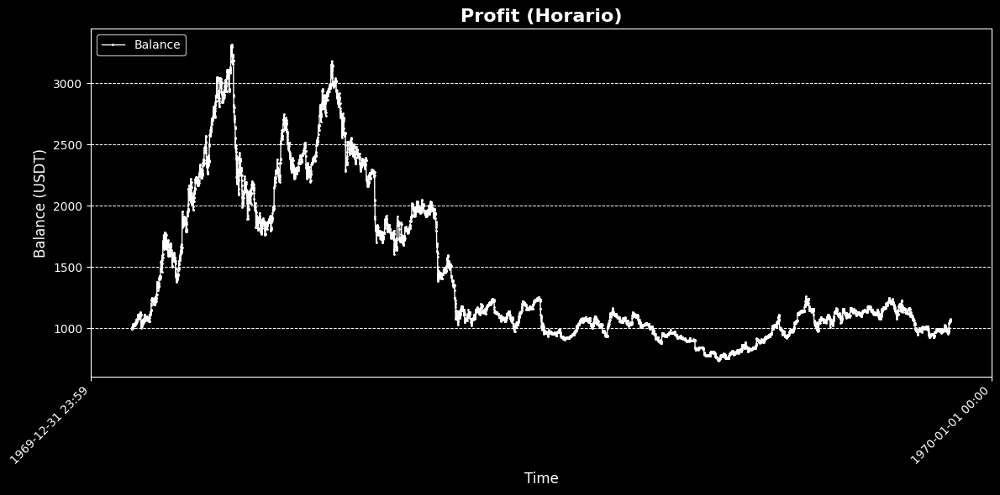

In [36]:
from datetime import datetime

# Inicializa listas para almacenar las marcas de tiempo y los valores de capital de cada venta horaria
timestamps = []  # Lista de timestamps para cada venta horaria
account = []     # Lista de capital después de cada venta

# Convierte las claves de 'seguimiento_capital_horario' (timestamps) a formato UTC
for time_stamp in seguimiento_capital_horario.keys():
    timestamps.append(datetime.utcfromtimestamp(time_stamp / 1000))  # Convierte de milisegundos a segundos

# Almacena los valores de capital después de cada venta en la lista 'account'
for transacction in seguimiento_capital_horario.values():
    account.append(float(transacction))

# Configura el estilo de la gráfica a fondo oscuro para mejorar la visualización
mpl.style.use('dark_background')

# Crea una figura y un eje con dimensiones de 12x6 pulgadas
fig, ax = mpl.subplots(figsize=(12, 6))

# Dibuja la línea de evolución del capital después de cada venta
ax.plot(
    timestamps,        # Eje x: Timestamps horarios de cada venta
    account,           # Eje y: Capital después de cada venta
    color='white',     # Color de la línea en blanco
    marker='o',        # Marcador de cada punto en forma de círculo
    linestyle='-',     # Línea continua entre los puntos
    linewidth=1,       # Grosor de la línea
    markersize=1,      # Tamaño de los marcadores
    label='Balance'    # Etiqueta de la línea para la leyenda
)

# Configura el formato de las etiquetas del eje x a fecha y hora (AAAA-MM-DD HH:MM)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))

# Establece un localizador para el eje x con intervalos de 10 horas
ax.xaxis.set_major_locator(mdates.HourLocator(interval=10))

# Título de la gráfica con un tamaño de fuente grande y en negrita
mpl.title('Profit (Horario)', fontsize=16, fontweight='bold')
# Etiquetas de los ejes x e y con un tamaño de fuente moderado
mpl.xlabel('Time', fontsize=12)
mpl.ylabel('Balance (USDT)', fontsize=12)

# Rota las etiquetas del eje x para mejorar la legibilidad y las alinea a la derecha
mpl.xticks(rotation=45, ha='right')

# Agrega una leyenda en la esquina superior izquierda de la gráfica
mpl.legend(loc='upper left')

# Activa la cuadrícula con líneas de estilo punteado y grosor moderado
mpl.grid(True, which='both', linestyle='--', linewidth=0.7)

# Ajusta el diseño para evitar el solapamiento de elementos
mpl.tight_layout()

# Muestra la gráfica en pantalla
mpl.show()



1. **Datos de la Gráfica**:
   - La gráfica utiliza las marcas de tiempo y los valores de capital tras cada venta horaria registrados en `seguimiento_capital_horario`.
   - La línea muestra la evolución del capital después de cada operación de venta a lo largo del tiempo.

2. **Configuración de la Visualización**:
   - La gráfica tiene un fondo oscuro, un formato de fecha y hora para el eje x, y un intervalo de 10 horas en las etiquetas del eje x.
   - Los puntos representan las ventas y muestran cómo fluctúa el capital después de cada operación, permitiendo evaluar la efectividad de la estrategia de trading.

Esta visualización proporciona una representación clara de la evolución del capital en cada punto de venta, ofreciendo información valiosa sobre la estabilidad y el crecimiento del capital con la estrategia de trading horaria.


#### Daily

### Gráfica de Evolución del Capital Diario Tras Cada Venta
Vizualizamos la evolución del capital diario tras cada operación de venta registrada en la simulación de trading diaria. Utilizando los datos de `seguimiento_capital_diario`, se genera una gráfica de línea que muestra el capital disponible después de cada venta diaria, permitiendo observar el rendimiento de la estrategia de trading en un marco de tiempo más amplio.


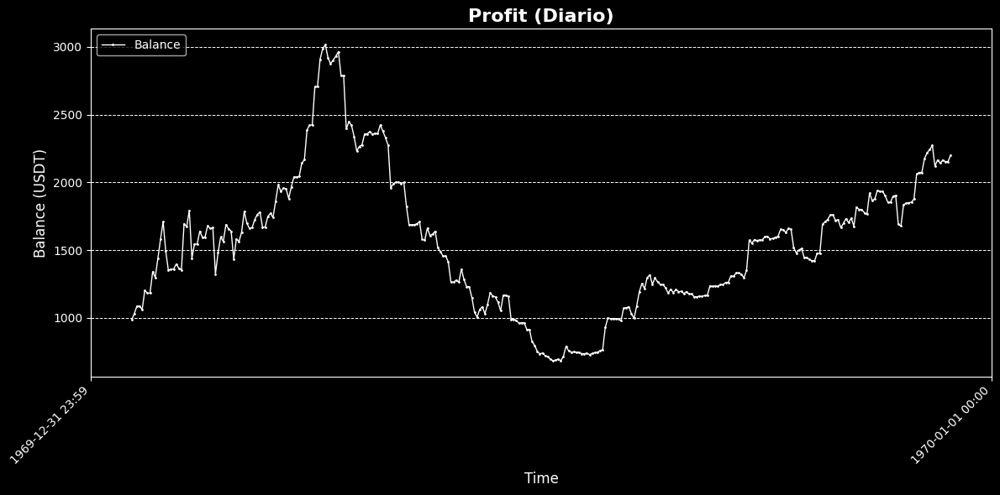

In [38]:
# Inicializa listas para almacenar las marcas de tiempo y los valores de capital de cada venta diaria
timestamps = []  # Lista de timestamps para cada venta diaria
account = []     # Lista de capital después de cada venta diaria

# Convierte las claves de 'seguimiento_capital_diario' (timestamps) a formato UTC
for time_stamp in seguimiento_capital_diario.keys():
    timestamps.append(datetime.utcfromtimestamp(time_stamp / 1000))  # Convierte de milisegundos a segundos

# Almacena los valores de capital después de cada venta en la lista 'account'
for transacction in seguimiento_capital_diario.values():
    account.append(float(transacction))

# Configura el estilo de la gráfica a fondo oscuro para mejorar la visualización
mpl.style.use('dark_background')

# Crea una figura y un eje con dimensiones de 12x6 pulgadas
fig, ax = mpl.subplots(figsize=(12, 6))

# Dibuja la línea de evolución del capital después de cada venta diaria
ax.plot(
    timestamps,        # Eje x: Timestamps diarios de cada venta
    account,           # Eje y: Capital después de cada venta diaria
    color='white',     # Color de la línea en blanco
    marker='o',        # Marcador de cada punto en forma de círculo
    linestyle='-',     # Línea continua entre los puntos
    linewidth=1,       # Grosor de la línea
    markersize=1,      # Tamaño de los marcadores
    label='Balance'    # Etiqueta de la línea para la leyenda
)

# Configura el formato de las etiquetas del eje x a fecha y hora (AAAA-MM-DD HH:MM)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))

# Establece un localizador para el eje x con intervalos de 100 horas
ax.xaxis.set_major_locator(mdates.HourLocator(interval=100))

# Título de la gráfica con un tamaño de fuente grande y en negrita
mpl.title('Profit (Diario)', fontsize=16, fontweight='bold')
# Etiquetas de los ejes x e y con un tamaño de fuente moderado
mpl.xlabel('Time', fontsize=12)
mpl.ylabel('Balance (USDT)', fontsize=12)

# Rota las etiquetas del eje x para mejorar la legibilidad y las alinea a la derecha
mpl.xticks(rotation=45, ha='right')

# Agrega una leyenda en la esquina superior izquierda de la gráfica
mpl.legend(loc='upper left')

# Activa la cuadrícula con líneas de estilo punteado y grosor moderado
mpl.grid(True, which='both', linestyle='--', linewidth=0.7)

# Ajusta el diseño para evitar el solapamiento de elementos
mpl.tight_layout()

# Muestra la gráfica en pantalla
mpl.show()


1. **Datos de la Gráfica**:
   - La gráfica utiliza las marcas de tiempo y los valores de capital tras cada venta diaria registrados en `seguimiento_capital_diario`.
   - La línea muestra la evolución del capital después de cada operación de venta diaria a lo largo del tiempo.

2. **Configuración de la Visualización**:
   - La gráfica tiene un fondo oscuro, un formato de fecha y hora para el eje x, y un intervalo de 100 horas en las etiquetas del eje x.
   - Los puntos representan las ventas y muestran cómo fluctúa el capital después de cada operación, permitiendo evaluar la efectividad de la estrategia de trading en el marco de tiempo diario.

Esta visualización proporciona una representación clara de la evolución del capital en cada punto de venta diario, lo que permite evaluar si la estrategia a nivel diario es eficaz en términos de crecimiento y estabilidad del capital.

# Complex State Declaration


### Función `traduccion_movimientos_tres` para Agrupación de Cambios de Precio en Secuencias de Tres
La función, `traduccion_movimientos_tres`, agrupa cambios porcentuales de precio en secuencias de tres estados consecutivos. Permite analizar estos cambios en bloques, lo cual es útil para identificar patrones de cambio en el mercado.

#### Parámetros
- **`cambios_porcentuales`**: Diccionario con fechas y cambios porcentuales de precios.
- **`modo`**: Define si los cambios se traducen a estados (`'subida'`, `'bajada'`, `'estable'`) o valores numéricos (1, -1, 0). Los valores posibles son `'estados'` y `'numeros'`.

#### Salida
Devuelve un diccionario, `matriz_cambios`, donde cada clave es una fecha, y cada valor es una lista con tres cambios consecutivos, en formato de estado o numérico, según el parámetro `modo`.


In [39]:
def traduccion_movimientos_tres(cambios_porcentuales, modo='estados'):
    matriz_cambios = {}  # Diccionario para almacenar las secuencias de tres estados por fecha

    historial = []       # Lista para almacenar los tres últimos estados
    proximo_i = 2        # Índice en el que se almacena la próxima secuencia de tres estados

    # Iterar sobre los cambios porcentuales
    for i, (fecha, valor) in enumerate(cambios_porcentuales.items()):
        
        # Traducir el valor a un estado según el modo
        if modo == 'estados':
            if valor > 0.5:
                historial.append(estados[1])  # Subida
            elif valor < -0.5:
                historial.append(estados[0])  # Bajada
            else:
                historial.append(estados[2])  # Estable
            
            # Si se alcanza el tercer cambio consecutivo, se guarda en 'matriz_cambios'
            if proximo_i == i:
                matriz_cambios[fecha] = historial  # Almacena la secuencia de tres estados
                historial = []                     # Reinicia historial para la siguiente secuencia
                proximo_i += 3                     # Actualiza el índice para la próxima secuencia

        # Traducción de los cambios porcentuales a valores numéricos en lugar de estados
        elif modo == 'numeros':
            if valor > 0.5:
                historial.append(1)  # Subida
            elif valor < -0.5:
                historial.append(-1)  # Bajada
            else:
                historial.append(0)  # Estable
            
            # Condición para almacenar una secuencia de tres cambios en 'matriz_cambios'
            if proximo_i == i:
                matriz_cambios[fecha] = historial  # Almacena la secuencia numérica de tres cambios
                historial = []                     # Reinicia historial para la siguiente secuencia
                proximo_i += 3                     # Actualiza el índice para la próxima secuencia
        else:
            return 'Tienes que dar un modo válido'  # Devuelve error si el modo es incorrecto

    return matriz_cambios  # Devuelve el diccionario con las secuencias de tres cambios de cada fecha


### Explicación de la Lógica del Código
1. **Inicialización de Variables**:
   - `matriz_cambios` es el diccionario de salida que almacenará las secuencias de tres estados.
   - `historial` es una lista que guarda temporalmente tres cambios de estado consecutivos.
   - `proximo_i` define el índice en el que se guardará el próximo bloque de tres estados.

2. **Iteración y Traducción de Cambios**:
   - La función recorre cada elemento en `cambios_porcentuales`, traduciendo cada cambio porcentual en un estado (`'subida'`, `'bajada'`, `'estable'`) o en un valor numérico (1, -1, 0).
   - Al alcanzar tres cambios consecutivos (cuando `i` coincide con `proximo_i`), la secuencia de tres estados se almacena en `matriz_cambios`, y `historial` se reinicia para la próxima secuencia.

3. **Condición de Modo**:
   - Si el parámetro `modo` no es `'estados'` o `'numeros'`, la función devuelve un mensaje de error para indicar que el modo proporcionado es incorrecto.

Esta función permite construir secuencias de tres cambios consecutivos de precios, útiles para identificar patrones de comportamiento del mercado en bloques de tres. Esta información puede alimentar modelos de predicción de patrones y facilitar el análisis de tendencias del mercado.


In [40]:
# Genera matrices de secuencias de tres cambios de estado para intervalos horarios y diarios
matriz_tres_cambios_estados_horaria = traduccion_movimientos_tres(profit_percentage_hourly)  # Estados en formato descriptivo (horaria)
matriz_tres_cambios_numeros_horaria = traduccion_movimientos_tres(profit_percentage_hourly, 'numeros')  # Estados en formato numérico (horaria)
matriz_tres_cambios_estados_diaria = traduccion_movimientos_tres(profit_percentage_daily)  # Estados en formato descriptivo (diaria)
matriz_tres_cambios_numeros_diaria = traduccion_movimientos_tres(profit_percentage_daily, 'numeros')  # Estados en formato numérico (diaria)

# Visualiza la matriz de secuencias de tres cambios de estado en formato descriptivo para intervalos horarios
matriz_tres_cambios_estados_horaria


{1604973599999: ['subida', 'estable', 'subida'],
 1604984399999: ['estable', 'estable', 'estable'],
 1604995199999: ['estable', 'bajada', 'estable'],
 1605005999999: ['subida', 'estable', 'bajada'],
 1605016799999: ['estable', 'estable', 'estable'],
 1605027599999: ['bajada', 'estable', 'subida'],
 1605038399999: ['estable', 'estable', 'estable'],
 1605049199999: ['estable', 'subida', 'estable'],
 1605059999999: ['estable', 'subida', 'estable'],
 1605070799999: ['estable', 'estable', 'estable'],
 1605081599999: ['estable', 'estable', 'estable'],
 1605092399999: ['estable', 'estable', 'subida'],
 1605103199999: ['estable', 'estable', 'estable'],
 1605113999999: ['subida', 'estable', 'subida'],
 1605124799999: ['subida', 'estable', 'estable'],
 1605135599999: ['bajada', 'subida', 'estable'],
 1605146399999: ['bajada', 'estable', 'estable'],
 1605157199999: ['estable', 'estable', 'estable'],
 1605167999999: ['subida', 'estable', 'estable'],
 1605178799999: ['estable', 'subida', 'bajada'],

### Explicación de las Matrices de Secuencias de Tres Cambios
1. **Matrices de Cambios Horarios y Diarios**:
   - Se crean cuatro matrices:
     - `matriz_tres_cambios_estados_horaria`: Cambios horarios en formato de estado (`'subida'`, `'bajada'`, `'estable'`).
     - `matriz_tres_cambios_numeros_horaria`: Cambios horarios en formato numérico (1, -1, 0).
     - `matriz_tres_cambios_estados_diaria`: Cambios diarios en formato de estado.
     - `matriz_tres_cambios_numeros_diaria`: Cambios diarios en formato numérico.

2. **Interpretación**:
   - Cada elemento en estas matrices es una lista de tres estados consecutivos, lo que permite estudiar patrones de cambio de precio en bloques, como una serie de subidas o bajadas.
   - Esta estructura es útil para identificar secuencias repetitivas en el mercado y puede servir para construir predicciones basadas en modelos de cadenas de Markov.

El análisis de estas secuencias de tres cambios puede ayudar a comprender la probabilidad de ciertos patrones de mercado, proporcionando una herramienta adicional para evaluar la consistencia de tendencias en intervalos de tiempo más largos o cortos.


# Complex Markov Chain Algorithm (Observing +3 Past States)

## If we observe 3 past states, we have to consider 3^3=27 possible combinations of states, so our state vector changes

##  
    subida, subida, subida
    subida, subida, bajada
    subida, subida, estable
    subida, bajada, subida
    subida, bajada, bajada
    subida, bajada, estable
    subida, estable, subida
    ...
    ...

### Generación de Todas las Combinaciones de Tres Estados Consecutivos
Se generan todas las posibles combinaciones de tres estados consecutivos (`'bajada'`, `'subida'`, `'estable'`). Estas combinaciones se almacenan en una lista llamada `estados_tres`, y representan todas las secuencias posibles de tres estados que pueden ocurrir en el mercado. Esta lista es útil para construir una matriz de transición que capture las probabilidades de pasar de una combinación de tres estados a otra, en el contexto de un modelo de cadena de Markov.


In [41]:
# Lista de estados individuales
estados = ['bajada', 'subida', 'estable']

# Inicializa una lista para almacenar todas las combinaciones posibles de tres estados consecutivos
estados_tres = []

# Genera todas las combinaciones de tres estados usando tres bucles anidados
for estado1 in estados:
    for estado2 in estados:
        for estado3 in estados:
            estado_final = []                # Lista temporal para almacenar una combinación de tres estados
            estado_final.append(estado1)     # Agrega el primer estado
            estado_final.append(estado2)     # Agrega el segundo estado
            estado_final.append(estado3)     # Agrega el tercer estado
            estados_tres.append(estado_final)  # Guarda la combinación en la lista 'estados_tres'

# Muestra todas las combinaciones generadas de tres estados consecutivos
print(estados_tres)
print(f'Cada uno de estos estados será asignado en la matriz de transformación')


[['bajada', 'bajada', 'bajada'], ['bajada', 'bajada', 'subida'], ['bajada', 'bajada', 'estable'], ['bajada', 'subida', 'bajada'], ['bajada', 'subida', 'subida'], ['bajada', 'subida', 'estable'], ['bajada', 'estable', 'bajada'], ['bajada', 'estable', 'subida'], ['bajada', 'estable', 'estable'], ['subida', 'bajada', 'bajada'], ['subida', 'bajada', 'subida'], ['subida', 'bajada', 'estable'], ['subida', 'subida', 'bajada'], ['subida', 'subida', 'subida'], ['subida', 'subida', 'estable'], ['subida', 'estable', 'bajada'], ['subida', 'estable', 'subida'], ['subida', 'estable', 'estable'], ['estable', 'bajada', 'bajada'], ['estable', 'bajada', 'subida'], ['estable', 'bajada', 'estable'], ['estable', 'subida', 'bajada'], ['estable', 'subida', 'subida'], ['estable', 'subida', 'estable'], ['estable', 'estable', 'bajada'], ['estable', 'estable', 'subida'], ['estable', 'estable', 'estable']]
Cada uno de estos estados será asignado en la matriz de transformación


La lista `estados_tres` muestra todas las secuencias posibles de tres estados consecutivos, lo cual es útil para crear una matriz de transformación que evalúe las transiciones entre secuencias de tres estados en el mercado.

Esta estructura de combinaciones proporciona una base para modelar el comportamiento de cambio de estados en intervalos de tres, lo cual puede ser utilizado en el análisis de patrones de mercado mediante cadenas de Markov.

## So the transformation matrix would have 27 indexes and 3 futures states per index:


### Inicialización de una Matriz de Transición Avanzada para Secuencias de Tres Estados
Se crea una matriz de transición avanzada llamada `matriz_transicion_avanzada`, la cual se utilizará para almacenar las probabilidades de transición entre combinaciones de tres estados consecutivos y los posibles estados siguientes. La matriz tiene dimensiones (27, 3), lo que representa las 27 combinaciones posibles de tres estados consecutivos (como se generó en `estados_tres`) y los tres posibles estados a los que pueden transitar.

#### Detalles de la Matriz
- **Filas (27)**: Cada fila representa una de las combinaciones de tres estados consecutivos.
- **Columnas (3)**: Cada columna corresponde a uno de los posibles estados (`'bajada'`, `'subida'`, `'estable'`) a los que puede transitar cada combinación de tres estados.

Esta matriz se inicializa con ceros y será rellenada con las probabilidades de transición observadas, proporcionando una estructura avanzada para modelar transiciones en bloques de tres estados en un modelo de cadena de Markov.


In [42]:
# Inicializa una matriz de transición avanzada de 27 filas y 3 columnas, con todos los valores en cero
matriz_transicion_avanzada = np.zeros((27, 3))

# Muestra la matriz de transición avanzada inicializada
print('transicion_avanzada\n', matriz_transicion_avanzada)


transicion_avanzada
 [[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]


### Explicación de la Matriz de Transición Avanzada
- **Objetivo**: La matriz `matriz_transicion_avanzada` se utilizará para almacenar las probabilidades de transición desde cada combinación de tres estados consecutivos a cada uno de los posibles estados siguientes.
- **Dimensiones**: La matriz tiene 27 filas (una por cada combinación de tres estados) y 3 columnas (una por cada estado siguiente posible).
  
Esta matriz servirá como una representación más compleja de la dinámica del mercado, capturando transiciones no solo entre estados individuales, sino entre secuencias de estados. Esto permite analizar patrones de cambio a un nivel más detallado en un modelo de cadena de Markov avanzado.


## Markov Transition Matrix

### We will also make 2 transition matrixes to see how both timeframes change

#### Hourly

### Construcción de la Matriz de Transición Avanzada Normalizada para Secuencias de Tres Estados en Intervalos Horarios
Se rellena la matriz de transición avanzada (`matriz_transicion_avanzada`) con los conteos de transiciones observadas entre combinaciones de tres estados consecutivos y el siguiente estado. Esta matriz captura la probabilidad de que una secuencia de tres estados transite a uno de los tres posibles estados (`'bajada'`, `'subida'`, `'estable'`). Al final, la matriz se normaliza para representar las probabilidades de transición.

#### Detalles del Proceso
1. **Ordenación de Fechas**:
   - `fechas_ordenadas` organiza las fechas de `matriz_cambios_estados_horarios` en orden cronológico para asegurar la secuencia temporal.

2. **Iteración y Contabilización de Transiciones**:
   - Se itera sobre las fechas comenzando en el tercer elemento (`i=2`) para trabajar con bloques de tres estados.
   - Para cada fecha, se obtiene:
     - `estado_actual`: La secuencia de tres estados en la fecha actual.
     - `estado_mañana`: El estado único al siguiente intervalo (fecha siguiente).
   - Los índices de `estado_actual` y `estado_mañana` se calculan con `estados_tres.index` y `estados.index`, respectivamente.
   - Se incrementa la celda correspondiente en `matriz_transicion_avanzada` para reflejar la transición observada.

3. **Normalización de la Matriz**:
   - `matriz_transicion_avanzada` se normaliza dividiendo cada fila por la suma de sus elementos, transformándola en `matriz_transicion_avanzada_normalizada_horaria`, que representa las probabilidades de transición.

Esta matriz normalizada es fundamental para un modelo de cadena de Markov avanzado, permitiendo realizar predicciones basadas en secuencias de tres estados y facilitando un análisis detallado de patrones de cambio de estado en el mercado.


In [43]:
# Ordena las fechas en orden cronológico para mantener la secuencia temporal
fechas_ordenadas = sorted(matriz_cambios_estados_horarios.keys())

# Itera sobre las fechas, trabajando con bloques de tres, para capturar transiciones avanzadas
for i in range(2, len(fechas_ordenadas)-1, 3):
    fecha_actual = fechas_ordenadas[i]       # Fecha actual correspondiente a una secuencia de tres estados
    fecha_mañana = fechas_ordenadas[i+1]     # Fecha del siguiente estado

    # Obtiene la secuencia de tres estados en la fecha actual
    estado_actual = matriz_tres_cambios_estados_horaria[fecha_actual]
    # Obtiene el estado único al siguiente intervalo (fecha siguiente)
    estado_mañana = matriz_cambios_estados_horarios[fecha_mañana]

    # Encuentra los índices en la lista de combinaciones de tres estados y en la lista de estados
    estado1 = estados_tres.index(estado_actual)
    estado2 = estados.index(estado_mañana)

    # Incrementa la posición correspondiente en la matriz de transición avanzada
    matriz_transicion_avanzada[estado1, estado2] += 1 

# Normaliza la matriz de transición avanzada para obtener probabilidades de transición
matriz_transicion_avanzada_normalizada_horaria = matriz_transicion_avanzada / matriz_transicion_avanzada.sum(axis=1, keepdims=True)



1. **Construcción de la Matriz**:
   - La matriz de transición avanzada se construye incrementando los conteos de transición observados entre cada secuencia de tres estados y su estado siguiente.

2. **Normalización**:
   - Cada fila de `matriz_transicion_avanzada` se divide entre la suma de sus elementos para obtener `matriz_transicion_avanzada_normalizada_horaria`, la cual representa la probabilidad de cada transición.

Esta matriz avanzada permite capturar y predecir cambios en el mercado con base en secuencias de tres estados consecutivos, proporcionando un análisis detallado de las probabilidades de transición que puede ser usado en un modelo de cadena de Markov de orden superior.


#### Daily

### Construcción de la Matriz de Transición Avanzada Normalizada para Secuencias de Tres Estados en Intervalos Diarios
En esta celda, se rellena la matriz de transición avanzada (`matriz_transicion_avanzada`) con los conteos de transiciones observadas entre combinaciones de tres estados consecutivos y el siguiente estado, pero aplicando los datos diarios. Esta matriz captura la probabilidad de que una secuencia de tres estados transite a uno de los tres posibles estados (`'bajada'`, `'subida'`, `'estable'`) en el intervalo diario. Finalmente, la matriz se normaliza para representar las probabilidades de transición para los datos diarios.

#### Detalles del Proceso
1. **Ordenación de Fechas**:
   - `fechas_ordenadas` organiza las fechas de `matriz_cambios_estados_diarios` en orden cronológico para garantizar la secuencia temporal.

2. **Iteración y Contabilización de Transiciones**:
   - Se itera sobre las fechas comenzando en el tercer elemento (`i=2`) y avanzando en bloques de tres.
   - Para cada fecha, se obtiene:
     - `estado_actual`: La secuencia de tres estados en la fecha actual.
     - `estado_mañana`: El estado único al siguiente intervalo (fecha siguiente).
   - Los índices de `estado_actual` y `estado_mañana` se encuentran mediante `estados_tres.index` y `estados.index`, respectivamente.
   - Se incrementa la celda correspondiente en `matriz_transicion_avanzada` para reflejar la transición observada.

3. **Normalización de la Matriz**:
   - `matriz_transicion_avanzada` se normaliza dividiendo cada fila por la suma de sus elementos, generando `matriz_transicion_avanzada_normalizada_diaria`, que representa las probabilidades de transición para los datos diarios.

Esta matriz normalizada es fundamental para aplicar el modelo de cadena de Markov avanzado en un contexto diario, permitiendo realizar predicciones basadas en secuencias de tres estados diarios consecutivos.


In [44]:
# Ordena las fechas en orden cronológico para mantener la secuencia temporal de los datos diarios
fechas_ordenadas = sorted(matriz_cambios_estados_diarios.keys())

# Itera sobre las fechas, trabajando con bloques de tres, para capturar transiciones avanzadas en datos diarios
for i in range(2, len(fechas_ordenadas)-1, 3):
    fecha_actual = fechas_ordenadas[i]       # Fecha actual correspondiente a una secuencia de tres estados
    fecha_mañana = fechas_ordenadas[i+1]     # Fecha del siguiente estado

    # Obtiene la secuencia de tres estados en la fecha actual
    estado_actual = matriz_tres_cambios_estados_diaria[fecha_actual]
    # Obtiene el estado único al siguiente intervalo (fecha siguiente)
    estado_mañana = matriz_cambios_estados_diarios[fecha_mañana]

    # Encuentra los índices en la lista de combinaciones de tres estados y en la lista de estados
    estado1 = estados_tres.index(estado_actual)
    estado2 = estados.index(estado_mañana)

    # Incrementa la posición correspondiente en la matriz de transición avanzada
    matriz_transicion_avanzada[estado1, estado2] += 1 

# Normaliza la matriz de transición avanzada para obtener probabilidades de transición diarias
matriz_transicion_avanzada_normalizada_diaria = matriz_transicion_avanzada / matriz_transicion_avanzada.sum(axis=1, keepdims=True)


### Explicación de la Matriz de Transición Avanzada Normalizada Diaria
1. **Construcción de la Matriz**:
   - La matriz de transición avanzada se construye incrementando los conteos de transición observados entre cada secuencia de tres estados diarios y su estado siguiente.

2. **Normalización**:
   - Cada fila de `matriz_transicion_avanzada` se divide entre la suma de sus elementos para obtener `matriz_transicion_avanzada_normalizada_diaria`, que representa la probabilidad de cada transición en el contexto diario.

Esta matriz permite capturar y predecir cambios en el mercado sobre la base de secuencias de tres estados diarios consecutivos, proporcionando un análisis detallado de las probabilidades de transición diarias que puede ser utilizado en un modelo de cadena de Markov avanzado.


### Visualización de la Matriz de Transición Avanzada Normalizada Horaria y Creación de un Molde para Interpretación
Esta celda imprime la matriz de transición avanzada normalizada para los datos horarios (`matriz_transicion_avanzada_normalizada_horaria`) y genera una estructura llamada `molde`. El `molde` contiene descripciones textuales de las transiciones entre cada combinación de tres estados consecutivos y el posible estado siguiente. Esto facilita la interpretación de la matriz, ayudando a relacionar cada índice con una transición específica en términos de estados de mercado.


In [45]:
# Imprime la matriz de transición avanzada normalizada para los datos horarios
print(matriz_transicion_avanzada_normalizada_horaria)

# Inicializa una lista para almacenar las descripciones textuales de cada transición
molde = []

# Crea el molde con descripciones para todas las transiciones posibles de tres estados a un siguiente estado
for estado1 in estados_tres:        # Para cada combinación de tres estados consecutivos
    elem = []
    for estado2 in estados:          # Para cada estado siguiente posible ('bajada', 'subida', 'estable')
        respuesta = f'{estado1} --> {estado2}'  # Crea una descripción textual de la transición
        elem.append(respuesta)       # Agrega la transición al molde
    molde.append(elem)               # Agrega el conjunto de transiciones al molde

# Muestra el molde con las descripciones textuales de las transiciones
molde


[[0.25       0.43055556 0.31944444]
 [0.23214286 0.22321429 0.54464286]
 [0.25899281 0.20143885 0.53956835]
 [0.32142857 0.25       0.42857143]
 [0.2173913  0.27173913 0.51086957]
 [0.22282609 0.21195652 0.56521739]
 [0.25185185 0.25925926 0.48888889]
 [0.19512195 0.22560976 0.57926829]
 [0.14736842 0.11403509 0.73859649]
 [0.19178082 0.23287671 0.57534247]
 [0.2345679  0.30864198 0.45679012]
 [0.18709677 0.16774194 0.64516129]
 [0.24096386 0.31325301 0.44578313]
 [0.25       0.22619048 0.52380952]
 [0.21511628 0.23255814 0.55232558]
 [0.19463087 0.24832215 0.55704698]
 [0.19337017 0.21546961 0.59116022]
 [0.14890282 0.14576803 0.70532915]
 [0.22619048 0.26785714 0.50595238]
 [0.18817204 0.26344086 0.5483871 ]
 [0.13345196 0.17793594 0.6886121 ]
 [0.24827586 0.24827586 0.50344828]
 [0.18589744 0.12820513 0.68589744]
 [0.13166667 0.14666667 0.72166667]
 [0.15929204 0.19292035 0.64778761]
 [0.16666667 0.17210145 0.66123188]
 [0.08274996 0.07987794 0.83737211]]


[["['bajada', 'bajada', 'bajada'] --> bajada",
  "['bajada', 'bajada', 'bajada'] --> subida",
  "['bajada', 'bajada', 'bajada'] --> estable"],
 ["['bajada', 'bajada', 'subida'] --> bajada",
  "['bajada', 'bajada', 'subida'] --> subida",
  "['bajada', 'bajada', 'subida'] --> estable"],
 ["['bajada', 'bajada', 'estable'] --> bajada",
  "['bajada', 'bajada', 'estable'] --> subida",
  "['bajada', 'bajada', 'estable'] --> estable"],
 ["['bajada', 'subida', 'bajada'] --> bajada",
  "['bajada', 'subida', 'bajada'] --> subida",
  "['bajada', 'subida', 'bajada'] --> estable"],
 ["['bajada', 'subida', 'subida'] --> bajada",
  "['bajada', 'subida', 'subida'] --> subida",
  "['bajada', 'subida', 'subida'] --> estable"],
 ["['bajada', 'subida', 'estable'] --> bajada",
  "['bajada', 'subida', 'estable'] --> subida",
  "['bajada', 'subida', 'estable'] --> estable"],
 ["['bajada', 'estable', 'bajada'] --> bajada",
  "['bajada', 'estable', 'bajada'] --> subida",
  "['bajada', 'estable', 'bajada'] --> e

### Explicación del Código
1. **Impresión de la Matriz de Transición Normalizada**:
   - La matriz de transición avanzada normalizada horaria se imprime para visualizar las probabilidades de transición entre combinaciones de tres estados consecutivos y el siguiente estado.

2. **Creación del Molde de Transiciones**:
   - `molde` es una lista de listas que contiene descripciones textuales de cada transición posible en la matriz de transición avanzada.
   - Cada elemento de `molde` muestra una transición en el formato `[estado1, estado2, estado3] --> estado_siguiente`, lo que facilita la interpretación de las transiciones en términos de combinaciones de estados de mercado.

Este molde es útil para interpretar los índices de la matriz de transición, permitiendo relacionar cada posición en la matriz con una transición específica. Esto ayuda a visualizar de manera clara las probabilidades de cambio de un conjunto de tres estados consecutivos a un siguiente estado en el modelo de cadena de Markov avanzado.


## Modelo de prediccion avanzado

### Función `predecir_estado_avanzado` para Predecir el Próximo Estado Basado en Secuencias de Tres Estados
La función `predecir_estado_avanzado` utiliza una matriz de transición avanzada normalizada para predecir el próximo estado del mercado a partir de una combinación de tres estados consecutivos. Esta predicción se basa en las probabilidades de transición en `matriz_transicion_avanzada_normalizada_horaria`, que captura las probabilidades de cambio para secuencias de tres estados.

#### Parámetros
- **`estado_actual`**: Una lista de tres estados consecutivos, como `['estable', 'subida', 'bajada']`.
- **`matriz_elegida`**: La matriz de transición avanzada normalizada utilizada para predecir el próximo estado. Por defecto, se usa `matriz_transicion_avanzada_normalizada_horaria`.

#### Retorno
Devuelve el estado actual (`estado_actual`) y el estado predicho (`estado_predecido`), lo cual permite evaluar la transición probable a partir de una combinación específica de tres estados.


In [46]:
def predecir_estado_avanzado(estado_actual, matriz_elegida = matriz_transicion_avanzada_normalizada_horaria):
    # Encuentra el índice de la combinación de tres estados consecutivos en la lista 'estados_tres'
    indice_estado_actual = estados_tres.index(estado_actual)

    # Selecciona el próximo estado usando las probabilidades en la matriz de transición avanzada para el estado actual
    estado_predecido = random.choices(estados, matriz_elegida[indice_estado_actual])[0]

    # Retorna la combinación de tres estados actual y el próximo estado predicho
    return estado_actual, estado_predecido


In [47]:
suma = 0  # Inicializa el contador de transiciones hacia 'subida'
for i in range(1000):
    # Predice el próximo estado desde la secuencia ['estable', 'estable', 'estable']
    k, v = predecir_estado_avanzado(['estable', 'estable', 'estable'], matriz_transicion_avanzada_normalizada_horaria)
    if v == 'subida':  # Si el estado predicho es 'subida', incrementa el contador
        suma += 1
# Calcula la proporción de predicciones que resultaron en 'subida'
print(suma / 1000)


0.09


### Explicación de la Simulación
1. **Simulación de Predicciones**:
   - La simulación llama a `predecir_estado_avanzado` 1000 veces, comenzando desde el estado `['estable', 'estable', 'estable']`.

2. **Cálculo de Probabilidad de Transición a `'subida'`**:
   - Cada vez que el estado predicho es `'subida'`, se incrementa el contador `suma`.
   - Al final, se calcula `suma / 1000` para obtener la probabilidad estimada de que el estado `['estable', 'estable', 'estable']` transite a `'subida'` en el modelo de cadena de Markov avanzado.

Esta probabilidad indica cuán probable es que el mercado pase a un estado de `'subida'` después de observar tres intervalos consecutivos en el estado `'estable'`, proporcionando una medida útil en el análisis de patrones de cambio de estado.


### As we see, prediction goes as planned

# Backtesting 2

### Backtesting con TF Horario

### Backtesting 2: Estrategia de Trading Basada en Predicciones Avanzadas con Secuencias de Tres Estados

Este backtesting simula una estrategia de trading basada en predicciones avanzadas utilizando secuencias de tres estados consecutivos (`'subida'`, `'bajada'`, `'estable'`). A partir de un estado inicial de tres periodos, el modelo predice el siguiente estado utilizando una matriz de transición avanzada, y toma decisiones de compra, venta o mantenimiento en función de estas predicciones. El objetivo es evaluar cómo esta estrategia afecta el capital a lo largo del tiempo en intervalos horarios.

#### Funcionamiento del Código:
1. **Inicialización de Variables**:
   - `capital_inicial`: Capital inicial en USD, y `capital` se actualiza durante la simulación.
   - `unidades`: Cantidad de BTC en posesión, actualizada en cada operación.
   - `estado_actual`: Estado inicial de tres periodos consecutivos, comenzando en `['estable', 'estable', 'estable']`.
   - `operaciones_totales` y `operaciones_venta`: Contadores para el total de operaciones de compra/venta y para ventas específicas.
   - `seguimiento_capital_horario`: Diccionario que almacena el capital tras cada venta, y `fechas_transacciones_horario` para registrar las fechas de cada venta.

2. **Simulación de Trading**:
   - Para cada fecha en los datos horarios (`price_trend_hourly`):
     - **Predicción del Estado Futuro**: Utilizando `predecir_estado_avanzado`, predice el próximo estado basándose en `estado_actual` y la matriz de transición avanzada.
     - **Compra**: Si el estado predicho es `'subida'` y hay capital disponible, compra la máxima cantidad de BTC posible.
     - **Venta**: Si el estado predicho es `'bajada'` y hay BTC en posesión, vende todas las unidades y registra el capital.
     - **Mantenimiento**: Si el estado predicho es `'estable'`, mantiene la posición sin realizar cambios.
   - Al final de la simulación, si quedan unidades, se venden al último precio disponible.

3. **Cálculo de Resultados Finales**:
   - Calcula la ganancia o pérdida neta y muestra el capital final, las unidades restantes, y el total de operaciones de compra y venta.


In [48]:
# Inicialización de variables para el backtesting
capital_inicial = 1000            # Capital inicial en USD
capital = capital_inicial          # Capital actual
unidades = 0                       # Número de unidades en posesión
estado_actual = ['estable', 'estable', 'estable']  # Estado inicial de tres estados consecutivos
operaciones_totales = 0            # Contador de operaciones de compra y venta
operaciones_venta = 0              # Contador específico para operaciones de venta
seguimiento_capital_horario = {}   # Diccionario para registrar el capital tras cada venta
fechas_transacciones_horario = {}  # Diccionario para registrar las fechas de cada venta

# Simulación de trading basada en predicciones avanzadas con secuencias de tres estados en intervalos horarios
for fecha in price_trend_hourly.keys():
    indice_actual = estados_tres.index(estado_actual)  # Encuentra el índice de la combinación actual de tres estados
    estado_ahora, estado_futuro = predecir_estado_avanzado(estado_actual, matriz_transicion_avanzada_normalizada_horaria)

    # Precio de BTC en la hora actual
    precio_hoy = price_trend_hourly[fecha]

    # Estrategia de compra: Si el estado futuro es 'subida' y hay capital disponible
    if estado_futuro == 'subida' and capital > 0:
        unidades = capital / float(precio_hoy)  # Compra la cantidad de BTC que se puede con el capital disponible
        capital = 0                             # Todo el capital se invierte en BTC
        print(f'+ Comprar en {fecha}: {unidades} unidades a {precio_hoy} USD')
        operaciones_totales += 1                # Incrementa el contador de operaciones

    # Estrategia de venta: Si el estado futuro es 'bajada' y hay unidades en posesión
    elif estado_futuro == 'bajada' and unidades > 0:
        capital = unidades * float(precio_hoy)  # Vende todas las unidades y actualiza el capital
        print(f"- Vender en {fecha}: capital total ahora es {capital} USD")
        unidades = 0                            # Se venden todas las unidades
        operaciones_totales += 1                # Incrementa el contador de operaciones
        operaciones_venta += 1                  # Incrementa el contador de operaciones de venta
        seguimiento_capital_horario[operaciones_venta] = capital  # Guarda el capital actual tras la venta
        fechas_transacciones_horario[operaciones_venta] = fecha   # Guarda la fecha de la venta

    # Estrategia de mantener posición: Si el estado futuro es 'estable' o no hay condiciones para comprar/vender
    else:
        print(f'· Holdear en {fecha} con {capital} capital y {unidades} unidades.')

# Si quedan unidades al final de la simulación, las vende al último precio disponible
if unidades > 0:
    capital += unidades * float(price_trend_hourly[fecha])

# Cálculo de ganancia o pérdida al final de la simulación
ganancia = capital - capital_inicial
print('*'* 100)
print(f'Capital final: {capital} USD, Ganancia/Pérdida: {ganancia} USD')
print(f'unidades finales: {unidades}')
print(f'Operaciones totales: {operaciones_totales}')


· Holdear en 1604962800000 con 1000 capital y 0 unidades.
+ Comprar en 1604966399999: 0.06523833848390016 unidades a 15328.41000000 USD
· Holdear en 1604966400000 con 0 capital y 0.06523833848390016 unidades.
· Holdear en 1604969999999 con 0 capital y 0.06523833848390016 unidades.
· Holdear en 1604970000000 con 0 capital y 0.06523833848390016 unidades.
· Holdear en 1604973599999 con 0 capital y 0.06523833848390016 unidades.
· Holdear en 1604973600000 con 0 capital y 0.06523833848390016 unidades.
- Vender en 1604977199999: capital total ahora es 1000.7000073719323 USD
· Holdear en 1604977200000 con 1000.7000073719323 capital y 0 unidades.
· Holdear en 1604980799999 con 1000.7000073719323 capital y 0 unidades.
· Holdear en 1604980800000 con 1000.7000073719323 capital y 0 unidades.
+ Comprar en 1604984399999: 0.06503330673416295 unidades a 15387.50000000 USD
· Holdear en 1604984400000 con 0 capital y 0.06503330673416295 unidades.
· Holdear en 1604987999999 con 0 capital y 0.06503330673416

### Resultados del Backtesting y Evaluación de Rendimiento
1. **Capital Final**: El capital en USD al final de la simulación muestra el saldo restante después de todas las operaciones.
2. **Ganancia/Pérdida**: La diferencia entre el capital final y el capital inicial refleja la rentabilidad total de la estrategia. Un valor positivo indica ganancias, mientras que un valor negativo indica pérdidas.
3. **unidades Finales**: Número de unidades restantes al cierre de la simulación (debería ser cero si se liquidaron todas).
4. **Operaciones Totales**: Número de operaciones de compra y venta ejecutadas a lo largo de la simulación, lo cual puede ser un indicador del nivel de actividad de la estrategia.

Este backtesting permite evaluar la efectividad de la estrategia basada en predicciones de secuencias de tres estados consecutivos, brindando una visión del rendimiento en intervalos horarios y permitiendo ajustes futuros en la estrategia de trading.


### Graphing the profit evolution

#### Hourly

### Gráfica de la Evolución del Capital Tras Cada Venta en la Simulación Horaria
En esta celda, se visualiza la evolución del capital después de cada venta realizada en el backtesting horario. Usando las fechas de transacciones (`fechas_transacciones_horario`) y el capital restante después de cada venta (`seguimiento_capital_horario`), se genera una gráfica de línea que muestra cómo fluctúa el capital a lo largo del tiempo, lo cual permite evaluar visualmente el rendimiento de la estrategia de trading.

#### Descripción del Proceso:
1. **Preparación de Datos para la Gráfica**:
   - `timestamps`: Lista de marcas de tiempo convertidas a formato UTC, usando las fechas en `fechas_transacciones_horario`.
   - `account`: Lista con los valores de capital después de cada venta, extraídos de `seguimiento_capital_horario`.

2. **Configuración de la Gráfica**:
   - Estilo de fondo oscuro para mejorar la visibilidad.
   - Configuración de la línea para que cada punto marque el balance después de una venta.
   - Formato de fecha en el eje x para mostrar tanto la fecha como la hora y establecer intervalos de 100 días.

3. **Visualización Final**:
   - La gráfica muestra la evolución del capital tras cada venta, ayudando a visualizar los momentos en que el capital aumenta o disminuye y a analizar la estabilidad de la estrategia de trading en un contexto horario.


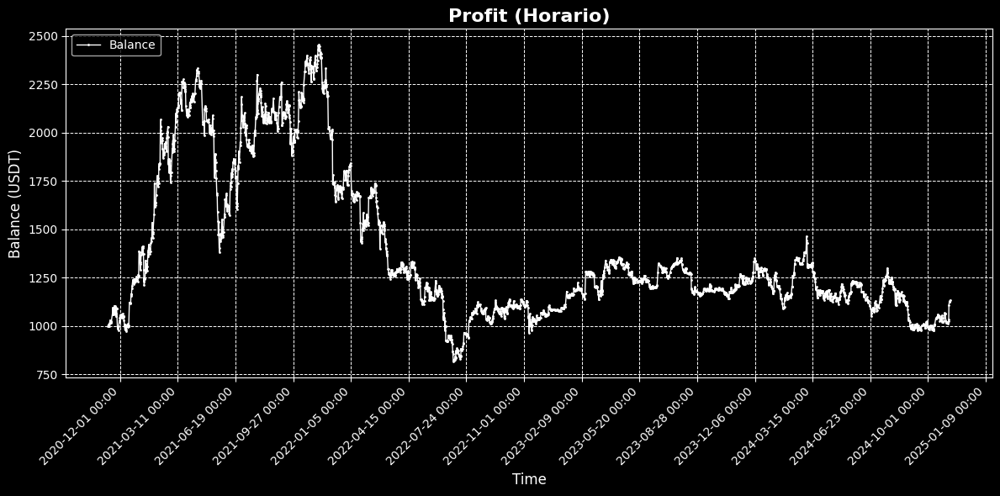

In [49]:
# Inicializa listas para almacenar las marcas de tiempo y los valores de capital de cada venta
timestamps = []  # Lista de timestamps para cada venta
account = []     # Lista de capital después de cada venta

# Convierte las claves de 'fechas_transacciones_horario' a formato UTC
for time_stamp in fechas_transacciones_horario.values():
    timestamps.append(datetime.utcfromtimestamp(time_stamp / 1000))  # Convierte de milisegundos a segundos

# Almacena los valores de capital después de cada venta en la lista 'account'
for transacction in seguimiento_capital_horario.values():
    account.append(float(transacction))

# Configura el estilo de la gráfica a fondo oscuro para mejorar la visualización
mpl.style.use('dark_background')

# Crea una figura y un eje con dimensiones de 12x6 pulgadas
fig, ax = mpl.subplots(figsize=(12, 6))

# Dibuja la línea de evolución del capital después de cada venta
ax.plot(
    timestamps,        # Eje x: Timestamps de cada venta
    account,           # Eje y: Capital después de cada venta
    color='white',     # Color de la línea en blanco
    marker='o',        # Marcador de cada punto en forma de círculo
    linestyle='-',     # Línea continua entre los puntos
    linewidth=1,       # Grosor de la línea
    markersize=1,      # Tamaño de los marcadores
    label='Balance'    # Etiqueta de la línea para la leyenda
)

# Configura el formato de las etiquetas del eje x a fecha y hora (AAAA-MM-DD HH:MM)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))

# Establece un localizador para el eje x con intervalos de 100 días
ax.xaxis.set_major_locator(mdates.DayLocator(interval=100))

# Título de la gráfica y etiquetas de los ejes
mpl.title('Profit (Horario)', fontsize=16, fontweight='bold')
mpl.xlabel('Time', fontsize=12)
mpl.ylabel('Balance (USDT)', fontsize=12)

# Rota las etiquetas del eje x para mejorar la legibilidad
mpl.xticks(rotation=45, ha='right')

# Agrega una leyenda en la esquina superior izquierda de la gráfica
mpl.legend(loc='upper left')

# Activa la cuadrícula para una mejor visualización de los puntos de venta
mpl.grid(True, which='both', linestyle='--', linewidth=0.7)

# Ajusta el diseño para evitar solapamiento de elementos
mpl.tight_layout()

# Muestra la gráfica en pantalla
mpl.show()



1. **Datos en la Gráfica**:
   - La línea muestra el capital después de cada venta, permitiendo observar cómo varía el balance a lo largo del tiempo.

2. **Patrones de Rendimiento**:
   - La gráfica permite identificar los momentos en que la estrategia generó ganancias o pérdidas en función de las decisiones de venta. 
   - Las fluctuaciones del capital indican la efectividad de las predicciones avanzadas en captar tendencias de subida y bajada en el mercado.

Esta visualización es una herramienta clave para evaluar la rentabilidad y estabilidad de la estrategia de trading avanzada, mostrando si los momentos de compra y venta lograron maximizar el capital a lo largo del tiempo.


### Backtesting con TF Diario

### Backtesting Diario con Predicciones Avanzadas Basadas en Secuencias de Tres Estados

Esta celda ejecuta un backtesting diario que utiliza secuencias de tres estados (`'subida'`, `'bajada'`, `'estable'`) para predecir el estado futuro y tomar decisiones de compra, venta o mantenimiento de BTCUSDT. A partir de un capital inicial, la estrategia decide si comprar o vender en función del estado predicho para maximizar las ganancias.

#### Funcionamiento del Código
1. **Inicialización**:
   - Define el capital inicial, la cantidad de unidades y el estado de mercado inicial.
   - Se crean contadores para el número de operaciones y diccionarios para registrar el capital tras cada venta y las fechas de las transacciones.

2. **Simulación de Trading**:
   - Para cada fecha, el modelo predice el estado futuro y toma decisiones:
     - **Compra** si el estado futuro es `'subida'` y hay capital disponible.
     - **Venta** si el estado futuro es `'bajada'` y se poseen unidades.
     - **Mantenimiento** si el estado es `'estable'`.
   - Registra el capital en cada venta y acumula las ganancias finales.

3. **Cálculo de Resultados**:
   - Al final de la simulación, se liquidan las unidades restantes y se calcula la ganancia o pérdida neta, junto con el total de operaciones realizadas.


In [50]:
# Inicialización de variables para el backtesting diario
capital_inicial = 1000            # Capital inicial en USD
capital = capital_inicial          # Capital actual
unidades = 0                       # Número de unidades en posesión
estado_actual = ['estable', 'estable', 'estable']  # Estado inicial de tres estados consecutivos
operaciones_totales = 0            # Contador de operaciones de compra y venta
operaciones_venta = 0              # Contador específico para operaciones de venta
seguimiento_capital_diario = {}    # Diccionario para registrar el capital tras cada venta
fechas_transacciones = {}          # Diccionario para registrar las fechas de cada venta

# Simulación de trading basada en predicciones avanzadas con secuencias de tres estados en intervalos diarios
for fecha in price_trend_daily.keys():
    indice_actual = estados_tres.index(estado_actual)  # Encuentra el índice de la combinación actual de tres estados
    estado_ahora, estado_futuro = predecir_estado_avanzado(estado_actual, matriz_transicion_avanzada_normalizada_diaria)

    # Precio de BTC en el día actual
    precio_hoy = price_trend_daily[fecha]

    # Estrategia de compra: Si el estado futuro es 'subida' y hay capital disponible
    if estado_futuro == 'subida' and capital > 0:
        unidades = capital / float(precio_hoy)  # Compra la cantidad de BTC que se puede con el capital disponible
        capital = 0                             # Todo el capital se invierte en BTC
        print(f'+ Comprar en {fecha}: {unidades} unidades a {precio_hoy} USD')
        operaciones_totales += 1                # Incrementa el contador de operaciones

    # Estrategia de venta: Si el estado futuro es 'bajada' y hay unidades en posesión
    elif estado_futuro == 'bajada' and unidades > 0:
        capital = unidades * float(precio_hoy)  # Vende todas las unidades y actualiza el capital
        print(f"- Vender en {fecha}: capital total ahora es {capital} USD")
        unidades = 0                            # Se venden todas las unidades
        operaciones_totales += 1                # Incrementa el contador de operaciones
        operaciones_venta += 1                  # Incrementa el contador de operaciones de venta
        seguimiento_capital_diario[operaciones_venta] = capital  # Guarda el capital actual tras la venta
        fechas_transacciones[operaciones_venta] = fecha          # Guarda la fecha de la venta

    # Estrategia de mantener posición: Si el estado futuro es 'estable' o no hay condiciones para comprar/vender
    else:
        print(f'· Holdear en {fecha} con {capital} capital y {unidades} unidades.')

# Si quedan unidades al final de la simulación, las vende al último precio disponible
if unidades > 0:
    capital += unidades * float(price_trend_daily[fecha])

# Cálculo de ganancia o pérdida al final de la simulación
ganancia = capital - capital_inicial
print('*'* 100)
print(f'Capital final: {capital} USD, Ganancia/Pérdida: {ganancia} USD')
print(f'unidades finales: {unidades}')
print(f'Operaciones totales: {operaciones_totales}')


· Holdear en 1604966400000 con 1000 capital y 0 unidades.
· Holdear en 1605052799999 con 1000 capital y 0 unidades.
· Holdear en 1605052800000 con 1000 capital y 0 unidades.
· Holdear en 1605139199999 con 1000 capital y 0 unidades.
· Holdear en 1605139200000 con 1000 capital y 0 unidades.
· Holdear en 1605225599999 con 1000 capital y 0 unidades.
· Holdear en 1605225600000 con 1000 capital y 0 unidades.
· Holdear en 1605311999999 con 1000 capital y 0 unidades.
· Holdear en 1605312000000 con 1000 capital y 0 unidades.
· Holdear en 1605398399999 con 1000 capital y 0 unidades.
· Holdear en 1605398400000 con 1000 capital y 0 unidades.
· Holdear en 1605484799999 con 1000 capital y 0 unidades.
· Holdear en 1605484800000 con 1000 capital y 0 unidades.
· Holdear en 1605571199999 con 1000 capital y 0 unidades.
· Holdear en 1605571200000 con 1000 capital y 0 unidades.
+ Comprar en 1605657599999: 0.05662712960477661 unidades a 17659.38000000 USD
- Vender en 1605657600000: capital total ahora es 10

### Resultados del Backtesting Diario
1. **Capital Final y Ganancia/Pérdida**:
   - El capital final y la ganancia/pérdida neta en USD muestran el rendimiento de la estrategia desde el capital inicial hasta el cierre de la simulación.

2. **unidades Finales**:
   - Muestra el número de unidades restantes (BTC), que debería ser cero si se vendieron todas al final.

3. **Operaciones Totales**:
   - Indica la cantidad total de operaciones de compra y venta ejecutadas, proporcionando una idea de la actividad de la estrategia.

Este análisis final permite evaluar la efectividad de la estrategia de trading diario con predicciones avanzadas, destacando si la combinación de secuencias de tres estados consecutivos ha sido rentable en la simulación.


### Graphing profit evolution

#### Daily

### Gráfica de la Evolución del Capital Tras Cada Venta en la Simulación Diaria
Esta celda visualiza el capital acumulado después de cada venta en el backtesting diario, permitiendo observar cómo se comportó el balance a lo largo del tiempo. Se utilizan las fechas de cada transacción (`fechas_transacciones`) y el capital restante tras cada venta (`seguimiento_capital_diario`).

#### Descripción del Proceso
1. **Preparación de Datos**:
   - `timestamps`: Convierte las fechas de transacciones a formato UTC.
   - `account`: Registra el capital después de cada venta diaria.

2. **Configuración de la Gráfica**:
   - Fondo oscuro, con marcadores para cada punto de venta.
   - Eje x formateado para mostrar la fecha y hora en intervalos de 100 días.
   - La gráfica muestra la evolución del capital en el tiempo, ofreciendo una representación visual de las ganancias y pérdidas.

Este análisis gráfico es clave para evaluar visualmente la efectividad de la estrategia de trading en intervalos diarios.


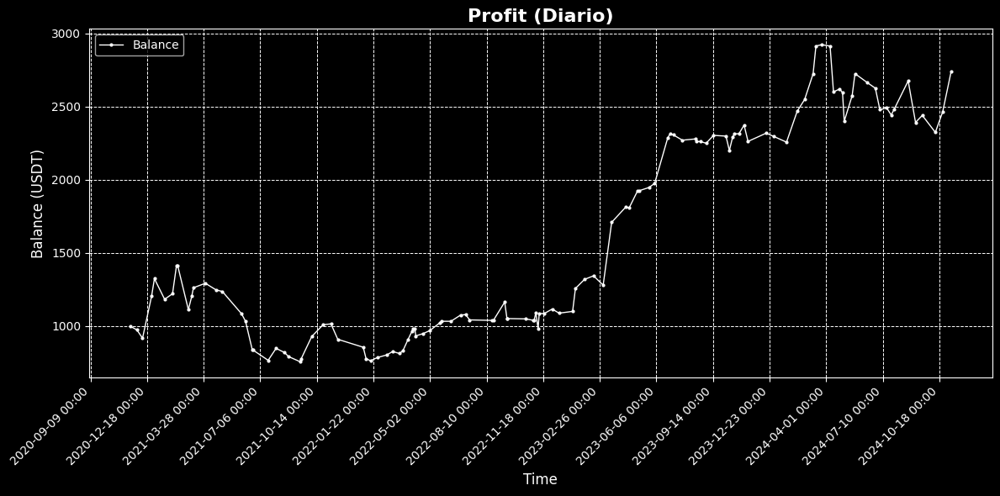

In [51]:
# Inicialización de listas para almacenar las marcas de tiempo y el capital tras cada venta
timestamps = []
account = []

# Convierte las fechas de transacciones a UTC y almacena los valores de capital tras cada venta
for time_stamp in fechas_transacciones.values():
    timestamps.append(datetime.utcfromtimestamp(time_stamp / 1000))

for transacction in seguimiento_capital_diario.values():
    account.append(float(transacction))

# Configuración de la gráfica con estilo de fondo oscuro
mpl.style.use('dark_background')

fig, ax = mpl.subplots(figsize=(12, 6))

# Dibuja la evolución del capital después de cada venta diaria
ax.plot(
    timestamps,
    account,
    color='white',
    marker='o',
    linestyle='-',
    linewidth=1,
    markersize=2,
    label='Balance'
)

# Formato de fecha en el eje x y configuración de intervalos
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
ax.xaxis.set_major_locator(mdates.DayLocator(interval=100))

# Títulos y etiquetas de los ejes
mpl.title('Profit (Diario)', fontsize=16, fontweight='bold')
mpl.xlabel('Time', fontsize=12)
mpl.ylabel('Balance (USDT)', fontsize=12)

mpl.xticks(rotation=45, ha='right')

# Leyenda y cuadrícula para facilitar la lectura
mpl.legend(loc='upper left')
mpl.grid(True, which='both', linestyle='--', linewidth=0.7)

# Ajusta el diseño y muestra la gráfica
mpl.tight_layout()
mpl.show()


### Interpretación de la Gráfica
1. **Evolución del Capital**:
   - La gráfica muestra el balance después de cada venta, indicando visualmente el rendimiento de la estrategia y los puntos en que el capital aumentó o disminuyó.

2. **Patrones de Rendimiento**:
   - La gráfica permite identificar si la estrategia captó correctamente las tendencias, mostrando cómo el capital varía a lo largo del tiempo.

Esta representación permite evaluar la consistencia de la estrategia diaria, observando si las predicciones avanzadas lograron mejorar el capital de manera estable o con volatilidad significativa.


In [ ]:
from binance.client import Client
import time
import random
import pandas as pd

# Configuración del cliente de Binance con API Key y Secret Key
def read_api_keys(file_path='API_KEY.txt'):
    with open(file_path, 'r') as file:
        lines = file.readlines()
        api_key = lines[0].split('=')[1].strip().strip('"')
        secret_key = lines[1].split('=')[1].strip().strip('"')
    return api_key, secret_key

API_KEY, API_SECRET = read_api_keys()
client = Client(API_KEY, API_SECRET, testnet=True)

class MarkovTradingBot:
    def __init__(self, symbol, profit_threshold=1.0, loss_threshold=-1.0, n_states=3):
        self.symbol = symbol
        self.balance = self.get_initial_balance()
        self.position = None
        self.entry_price = None
        self.profit_threshold = profit_threshold
        self.loss_threshold = loss_threshold
        self.n_states = n_states
        self.current_state = 0  # Estado inicial para el modelo de Markov

    def get_initial_balance(self):
        """Obtiene el balance inicial de la cuenta."""
        account_info = client.futures_account()
        balance = float(next(asset['marginBalance'] for asset in account_info['assets'] if asset['asset'] == 'USDT'))
        print(f"Balance inicial: {balance} USDT")
        return balance

    def get_current_price(self):
        ticker = client.get_symbol_ticker(symbol=self.symbol)
        return float(ticker["price"])

    def execute_trade(self, trade_amount, side):
        try:
            # Ajuste de precisión y cantidad mínima
            trade_amount = max(round(trade_amount, 3), 0.001)  # Ajuste básico para la precisión
            order = client.futures_create_order(
                symbol=self.symbol,
                side=side,
                type='MARKET',
                quantity=trade_amount
            )
            print(f"Orden ejecutada: {side} {trade_amount} {self.symbol} a precio de mercado.")
            return order
        except Exception as e:
            print(f"Error al ejecutar la orden: {e}")
            return None

    def calculate_markov_transition(self):
        # Ajuste de la lógica de transición para aumentar la probabilidad de cambio de estado
        transition_probabilities = [0.3, 0.35, 0.35]  # Probabilidades de [hold, buy, sell]
        self.current_state = random.choices([0, 1, 2], weights=transition_probabilities)[0]
        print(f"Transición de estado en el modelo de Markov: Estado actual -> {self.current_state}")
        return self.current_state


    def decide_trade(self):
        # Decidir acción basada en el estado
        if self.current_state == 0:
            print("Decisión de acción: Mantener (hold)")
            return "hold"
        elif self.current_state == 1:
            print("Decisión de acción: Comprar (buy)")
            return "buy"
        elif self.current_state == 2:
            print("Decisión de acción: Vender (sell)")
            return "sell"
        return "hold"

    def run(self):
        while True:
            current_price = self.get_current_price()
            print(f"Precio actual de {self.symbol}: {current_price} USDT")

            # Calcula el tamaño de la orden para garantizar un valor nominal de al menos 100 USDT
            trade_amount = max(0.001, 100 / current_price)

            if self.position is None and self.balance >= 100:
                # Decidir acción basada en el modelo de Markov
                action = self.decide_trade()
                if action == "buy":
                    order = self.execute_trade(trade_amount, Client.SIDE_BUY)
                    if order:
                        self.entry_price = current_price
                        self.position = "long"
                        self.balance -= trade_amount * current_price
                        print(f"Comprado {trade_amount} {self.symbol} a {current_price} USDT. Balance restante: {self.balance:.2f} USDT")

            elif self.position == "long":
                # Calcular ganancia o pérdida
                change = ((current_price - self.entry_price) / self.entry_price) * 100
                print(f"Precio actual: {current_price}, Variación desde la compra: {change:.2f}%")

                if change >= self.profit_threshold or change <= self.loss_threshold:
                    action = self.decide_trade()
                    if action == "sell":
                        order = self.execute_trade(trade_amount, Client.SIDE_SELL)
                        if order:
                            print(f"Vendido {trade_amount} {self.symbol} a {current_price} USDT con {change:.2f}% de cambio")
                            self.balance += trade_amount * current_price
                            self.position = None

            # Transición de estado en el modelo de Markov
            self.calculate_markov_transition()

            time.sleep(60)  # Pausa de 1 minuto

# Crear e iniciar el bot
bot = MarkovTradingBot(symbol="BTCUSDT")
bot.run()


Balance inicial: 17187.15798327 USDT
Precio actual de BTCUSDT: 76428.76 USDT
Decisión de acción: Mantener (hold)
Transición de estado en el modelo de Markov: Estado actual -> 2
Precio actual de BTCUSDT: 76421.11 USDT
Decisión de acción: Vender (sell)
Transición de estado en el modelo de Markov: Estado actual -> 0
